### Script for comparing different ocr-workflows
#### Goal: comparable value to evaluate the benefits of different text recognition approaches


**Step 1:** Read in data sets -gt.txt and -out.txt

**Step 2:** Fill dict according to lines

**Step 3:** Check output-lines for the similarity to groundtruth-lines (using SequenceMatcher)

**Step 4:** Perform for all text files within certain folder 

**Step 5:** Check the total percentage of similarity for each workflow

### Workflow: OCR4All
**Before:** Using the default parameters from semi-automated OCR4All-Workflow on .png files to generate text output

In [1]:
# import OS module to use operating system dependent functionalities
import os
os.path

<module 'ntpath' from 'C:\\Users\\merle\\AppData\\Local\\Programs\\Python\\Python310\\lib\\ntpath.py'>

In [2]:
# create list of all files in ./Stichprobe_OCR4all
file_list = os.listdir("./Stichprobe_OCR4ALL")
# create separated list for -gt.txt and -out.txt files
file_list_gt=[]
file_list_out=[]
for file in file_list:
    if file.endswith("-gt.txt"):
        file_list_gt.append(file)
    if file.endswith("-out.txt"):
        file_list_out.append(file)

In [3]:
# check output files list
file_list_out

['KaUf_73_1_0002-out.txt',
 'KaUf_73_1_0003-out.txt',
 'KaUf_73_1_0004-out.txt',
 'KaUf_73_1_0005-out.txt',
 'KaUf_74_1_0019-out.txt',
 'KaUf_74_1_0020-out.txt',
 'KaUf_74_1_0021-out.txt',
 'KaUf_74_1_0022-out.txt',
 'KaUf_74_2_0004-out.txt',
 'KaUf_74_2_0005-out.txt',
 'KaUf_74_2_0006-out.txt',
 'KaUf_74_2_0007-out.txt',
 'KaUf_75_1_0004-out.txt',
 'KaUf_75_1_0006-out.txt',
 'KaUf_75_1_0008-out.txt',
 'KaUf_75_1_0010-out.txt',
 'KaUf_76_1_0004-out.txt',
 'KaUf_76_1_0005-out.txt',
 'KaUf_76_1_0006-out.txt',
 'KaUf_76_1_0008-out.txt',
 'KaUf_76_2_0052-out.txt',
 'KaUf_76_2_0053-out.txt',
 'KaUf_76_2_0054-out.txt',
 'KaUf_76_2_0055-out.txt',
 'KaUf_77_1_0002-out.txt',
 'KaUf_77_1_0003-out.txt',
 'KaUf_77_1_0004-out.txt',
 'KaUf_77_1_0005-out.txt',
 'KaUf_77_2_0004-out.txt',
 'KaUf_77_2_0006-out.txt',
 'KaUf_77_2_0007-out.txt',
 'KaUf_77_2_0008-out.txt',
 'KaUf_78_1_0004-out.txt',
 'KaUf_78_1_0005-out.txt',
 'KaUf_78_1_0006-out.txt',
 'KaUf_78_1_0007-out.txt',
 'KaUf_79_1_0003-out.txt',
 

In [4]:
# check ground truth files list
file_list_gt

['KaUf_73_1_0002-gt.txt',
 'KaUf_73_1_0003-gt.txt',
 'KaUf_73_1_0004-gt.txt',
 'KaUf_73_1_0005-gt.txt',
 'KaUf_74_1_0019-gt.txt',
 'KaUf_74_1_0020-gt.txt',
 'KaUf_74_1_0021-gt.txt',
 'KaUf_74_1_0022-gt.txt',
 'KaUf_74_2_0004-gt.txt',
 'KaUf_74_2_0005-gt.txt',
 'KaUf_74_2_0006-gt.txt',
 'KaUf_74_2_0007-gt.txt',
 'KaUf_75_1_0004-gt.txt',
 'KaUf_75_1_0006-gt.txt',
 'KaUf_75_1_0008-gt.txt',
 'KaUf_75_1_0010-gt.txt',
 'KaUf_76_1_0004-gt.txt',
 'KaUf_76_1_0005-gt.txt',
 'KaUf_76_1_0006-gt.txt',
 'KaUf_76_1_0008-gt.txt',
 'KaUf_76_2_0052-gt.txt',
 'KaUf_76_2_0053-gt.txt',
 'KaUf_76_2_0054-gt.txt',
 'KaUf_76_2_0055-gt.txt',
 'KaUf_77_1_0002-gt.txt',
 'KaUf_77_1_0003-gt.txt',
 'KaUf_77_1_0004-gt.txt',
 'KaUf_77_1_0005-gt.txt',
 'KaUf_77_2_0004-gt.txt',
 'KaUf_77_2_0006-gt.txt',
 'KaUf_77_2_0007-gt.txt',
 'KaUf_77_2_0008-gt.txt',
 'KaUf_78_1_0004-gt.txt',
 'KaUf_78_1_0005-gt.txt',
 'KaUf_78_1_0006-gt.txt',
 'KaUf_78_1_0007-gt.txt',
 'KaUf_79_1_0003-gt.txt',
 'KaUf_79_1_0004-gt.txt',
 'KaUf_79_1_

In [5]:
# prepare dict with filename as key and lines as values (ground truth)
file_dict_gt= {}
for file_name in file_list_gt:
    file_dict_gt[file_name] = []

# for each file in list oft gt.txt files
for file_name in file_list_gt:    
    # open file
    file = open(f'./Stichprobe_OCR4ALL/{file_name}',"r",encoding='utf-8')
    # for each line in opened file
    for line in file:
        # remove \n
        line = line.strip("\n")
        if len(line) != 0:
            # add line to value of dict key of that file
            file_dict_gt[file_name].append(line)
    file.close()

print(file_dict_gt)

{'KaUf_73_1_0002-gt.txt': ['HAUPTSACHE FERIEN', 'Musik: Heinz Kiessling', 'Regie: Peter Weck', 'Darsteller: Peter Alexander, Christiane', 'Hörbiger, Theo Lingen, Martin Held', 'u. v. a.', 'Art: LUSTSPIEL', '418-1 ca. 120 m - S 8 - Color - Tonfilm', '418-3 ca. 120 m - S 8 - S/W - Tonfilm', 'Lehrer und Schüler haben am letzten Schultag', 'nur einen Gedanken: Hauptsache Ferien! Für', 'Studienrat Dr. Peter Markus und seine Toch-', 'ter Gaby bedeuten sie Sommer, Sonne, Cam-', 'ping! Für Corinna, Gabys Klassenkameradin, ', 'allerdings bringt der letzte Schultag nur die', 'Gewißheit: Sitzengeblieben! Corinna sieht al-', 'lerdings noch eine Möglichkeit: ihr reicher', 'Papa muß mit Geld den Weg zum Abitur', 'pflastern. Er soll Dr. Markus bestechen. Dieser', 'aber lehnt die Versetzung ab. Darum greift ihr', 'Vater zu einem letzte Mittel.', 'Ufa-Exclusiv-Serie', 'Hauptsache Ferien', 'Best.-Nr. 418, 419, 420 compl.', '= ca. 360 Meter - 60 Min.', 'PETER DER GROSSE', 'Musik: Heinz Kiessling', 'Regie

In [6]:
# prepare dict with filename as key and lines as values (output)
file_dict_out= {}
for file_name in file_list_out:
    file_dict_out[file_name] = []

# for each file in list oft text.txt files
for file_name in file_list_out:    
    # open file
    file = open(f'./Stichprobe_OCR4ALL/{file_name}',"r",encoding='utf-8') 
    # for each line in file
    for line in file:
        # remove \n
        line = line.strip("\n")
        if len(line) != 0:
            # add line to value of dict key of that file
            file_dict_out[file_name].append(line)
    file.close()

print(file_dict_out)

{'KaUf_73_1_0002-out.txt': ['HAUPTSACHE FERIEN', 'Musik: Heinz Kiessling', 'Regie: Peter Weck', 'Darsteller: Peter Alexander, Christiane', 'Horbiger, Theo Lingen, Martin Held', 'u. V. a.', 'Art: LUSTSPIEL', '418-1] ca. 120 m - S8 - Color - Tonfilm', '418-3 ca. 120 m - S 8 - S/W - Tonfilm', 'Lehrer und Schler haben am letzten Schultag', 'nur einen Gedanken: Hauptsache Ferien! Fur', 'Studienrat Dr. Peter Markus und seine Toch-', 'ter Gaby bedeuten sie Sommer, Sonne, Cam-', 'pingl Fir Corinna, Gabys Klassenkameradin,', 'allerdings bringt der letzte Schultag nur die', 'GewiBheit: Sitzengebliebenl Corinna sieht al-', 'lerdings noch eine Moglicheit: ihr reicher', 'Paa muB mit Geld den Weq zum Abitur', 'pflastern. Er soll Dr. Markus bestechen. Dieser', 'aber lehnt die Versetzung ab. Darum greift ihr', 'Vater zu einem letzten Mittel.', 'Ufa-Exclusiv-Serie', ",Hauptsache Ferien''", 'Best.-Nr. 418, 419, 420 compl.', 'ca. 360 Meter - 60 Min.', 'PETE DER GROSSE', 'Musik: Heinz Kiessling', 'Regie: 

In [7]:
# create result dict
result_dict = {}
for file_name in file_list_gt:
    result_dict[file_name.replace("-gt.txt", "")] = []
# check finished dict
result_dict

{'KaUf_73_1_0002': [],
 'KaUf_73_1_0003': [],
 'KaUf_73_1_0004': [],
 'KaUf_73_1_0005': [],
 'KaUf_74_1_0019': [],
 'KaUf_74_1_0020': [],
 'KaUf_74_1_0021': [],
 'KaUf_74_1_0022': [],
 'KaUf_74_2_0004': [],
 'KaUf_74_2_0005': [],
 'KaUf_74_2_0006': [],
 'KaUf_74_2_0007': [],
 'KaUf_75_1_0004': [],
 'KaUf_75_1_0006': [],
 'KaUf_75_1_0008': [],
 'KaUf_75_1_0010': [],
 'KaUf_76_1_0004': [],
 'KaUf_76_1_0005': [],
 'KaUf_76_1_0006': [],
 'KaUf_76_1_0008': [],
 'KaUf_76_2_0052': [],
 'KaUf_76_2_0053': [],
 'KaUf_76_2_0054': [],
 'KaUf_76_2_0055': [],
 'KaUf_77_1_0002': [],
 'KaUf_77_1_0003': [],
 'KaUf_77_1_0004': [],
 'KaUf_77_1_0005': [],
 'KaUf_77_2_0004': [],
 'KaUf_77_2_0006': [],
 'KaUf_77_2_0007': [],
 'KaUf_77_2_0008': [],
 'KaUf_78_1_0004': [],
 'KaUf_78_1_0005': [],
 'KaUf_78_1_0006': [],
 'KaUf_78_1_0007': [],
 'KaUf_79_1_0003': [],
 'KaUf_79_1_0004': [],
 'KaUf_79_1_0005': [],
 'KaUf_79_1_0006': [],
 'KaUf_79_2_0023': [],
 'KaUf_79_2_0024': [],
 'KaUf_79_2_0025': [],
 'KaUf_79_2

In [8]:
# SequenceMatcher: compare similarity of two strings by their ratio
from difflib import SequenceMatcher as SM

# iterate over keys in out.txt dict
for key in file_dict_gt:
    gt_value = file_dict_gt[key]
    # get beginning of file name and use it to extract value of out.txt dict
    out_value = file_dict_out[key.replace("-gt", "-out")]
    # for each pair of value compute distance measure 
    for string_gt in gt_value:
        print("*********************************************************")
        print("This is gt value:")
        print(string_gt)     
        best_ratio = 0
        for string_out in out_value:
            print("--------------------------------")
            print("Try fitting with this out value:")
            print(string_out)
            similarity_ratio = SM(None, string_gt, string_out).ratio()
            print(f'The score is: {similarity_ratio}')
            if similarity_ratio >= best_ratio:
                best_ratio = similarity_ratio
                best_string_out = string_out
        result_dict[key.replace("-gt.txt", "")].append({
            'groundtruth_line':string_gt,
            'output_line': best_string_out,
            'similarity_ratio': best_ratio })
        #if best_string_out in out_value:
            #out_value.remove(best_string_out)

*********************************************************
This is gt value:
HAUPTSACHE FERIEN
--------------------------------
Try fitting with this out value:
HAUPTSACHE FERIEN
The score is: 1.0
--------------------------------
Try fitting with this out value:
Musik: Heinz Kiessling
The score is: 0.10256410256410256
--------------------------------
Try fitting with this out value:
Regie: Peter Weck
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
Darsteller: Peter Alexander, Christiane
The score is: 0.07142857142857142
--------------------------------
Try fitting with this out value:
Horbiger, Theo Lingen, Martin Held
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
u. V. a.
The score is: 0.08
--------------------------------
Try fitting with this out value:
Art: LUSTSPIEL
The score is: 0.3870967741935484
--------------------------------
Try fitting with this out value:
418-1] ca. 120

The score is: 0.11320754716981132
--------------------------------
Try fitting with this out value:
DER SIERRA NEVADA
The score is: 0.06779661016949153
--------------------------------
Try fitting with this out value:
Musik: Marcello Giambini
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
egie: Primo Zeglio
The score is: 0.26666666666666666
--------------------------------
Try fitting with this out value:
Darsteller: Adam West, Robert Hundar,
The score is: 0.22784810126582278
--------------------------------
Try fitting with this out value:
Red oss
The score is: 0.16326530612244897
--------------------------------
Try fitting with this out value:
Art: ITALO-WESTERN
The score is: 0.1
--------------------------------
Try fitting with this out value:
2aa8 ca. 120 m - S 8 - S/W - Tonfilm
The score is: 0.05128205128205128
--------------------------------
Try fitting with this out value:
n einer kleinen Stadt des Westens morden
The score i

The score is: 0.08695652173913043
--------------------------------
Try fitting with this out value:
ca. 360 Meter - 60 Min.
The score is: 0.10256410256410256
--------------------------------
Try fitting with this out value:
TRITT EIN
The score is: 0.08
--------------------------------
Try fitting with this out value:
BRING GLUCK HEREIN
The score is: 0.17647058823529413
--------------------------------
Try fitting with this out value:
Musik: Heinz Kiessling
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
Regie: Peter Weck
The score is: 0.12121212121212122
--------------------------------
Try fitting with this out value:
Darsteller: Peter Alexander, Christiane
The score is: 0.10909090909090909
--------------------------------
Try fitting with this out value:
Horbiger, Theo Lingen, Martin Held
The score is: 0.12
--------------------------------
Try fitting with this out value:
u. V. a.
The score is: 0.16666666666666666
------------------

The score is: 0.13333333333333333
--------------------------------
Try fitting with this out value:
die Banditen einen Viehchter, berauben und
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
ermorden ihn. Zeuge dieses Verbrechens ist
The score is: 0.13333333333333333
--------------------------------
Try fitting with this out value:
ein junger Mann, der anger. Einer der Vier
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
ann SOa in den Kleidern des Rangers ent-
The score is: 0.20689655172413793
--------------------------------
Try fitting with this out value:
ommen. Die Witwe des Viehzichters ist der
The score is: 0.1694915254237288
--------------------------------
Try fitting with this out value:
Meinung, daB der junge Mann, den sie davon-
The score is: 0.19672131147540983
--------------------------------
Try fitting with this out value:
reiten sah, der Ranger war und daB er ihren
T

The score is: 0.2028985507246377
*********************************************************
This is gt value:
Vaters ist. Peter ist traurig und enttäuscht.
--------------------------------
Try fitting with this out value:
HAUPTSACHE FERIEN
The score is: 0.03225806451612903
--------------------------------
Try fitting with this out value:
Musik: Heinz Kiessling
The score is: 0.05970149253731343
--------------------------------
Try fitting with this out value:
Regie: Peter Weck
The score is: 0.3548387096774194
--------------------------------
Try fitting with this out value:
Darsteller: Peter Alexander, Christiane
The score is: 0.40476190476190477
--------------------------------
Try fitting with this out value:
Horbiger, Theo Lingen, Martin Held
The score is: 0.20253164556962025
--------------------------------
Try fitting with this out value:
u. V. a.
The score is: 0.18867924528301888
--------------------------------
Try fitting with this out value:
Art: LUSTSPIEL
The score is: 0.101694

The score is: 0.1568627450980392
--------------------------------
Try fitting with this out value:
a9- S 8 Color - Tonfilm
The score is: 0.13333333333333333
--------------------------------
Try fitting with this out value:
419-3 ca. 120 m - S8 - S/W - Tonfilm
The score is: 0.2191780821917808
--------------------------------
Try fitting with this out value:
Auf einem ihm qehorenden, ererbten Grund-
The score is: 0.1794871794871795
--------------------------------
Try fitting with this out value:
stuck direkt neben einem Campingplatz erfahrt
The score is: 0.21951219512195122
--------------------------------
Try fitting with this out value:
Peter Markus von einem Fertighaus-Gewinn.
The score is: 0.3076923076923077
--------------------------------
Try fitting with this out value:
Zusammen mit den aus allen deutschen Lan-
The score is: 0.23076923076923078
--------------------------------
Try fitting with this out value:
den stammenden Caminq-Freunden bauen
The score is: 0.273972602739726
--

The score is: 0.03333333333333333
--------------------------------
Try fitting with this out value:
Musik: Heinz Kiessling
The score is: 0.18461538461538463
--------------------------------
Try fitting with this out value:
Regie: Peter Weck
The score is: 0.23333333333333334
--------------------------------
Try fitting with this out value:
Darsteller: Peter Alexander, Christiane
The score is: 0.21951219512195122
--------------------------------
Try fitting with this out value:
Horbiger, Theo Lingen, Martin Held
The score is: 0.36363636363636365
--------------------------------
Try fitting with this out value:
u. V. a.
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
Art: LUSTSPIEL
The score is: 0.03508771929824561
--------------------------------
Try fitting with this out value:
418-1] ca. 120 m - S8 - Color - Tonfilm
The score is: 0.1951219512195122
--------------------------------
Try fitting with this out value:
418-3 ca. 120 m - S 8

The score is: 0.3050847457627119
--------------------------------
Try fitting with this out value:
Best.-Nr. 418, 419, 420 compl.
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
ca. 360 Meter - 60 Min.
The score is: 0.19672131147540983
--------------------------------
Try fitting with this out value:
TRITT EIN
The score is: 0.0425531914893617
--------------------------------
Try fitting with this out value:
BRING GLUCK HEREIN
The score is: 0.07142857142857142
--------------------------------
Try fitting with this out value:
Musik: Heinz Kiessling
The score is: 0.3
--------------------------------
Try fitting with this out value:
Regie: Peter Weck
The score is: 0.21818181818181817
--------------------------------
Try fitting with this out value:
Darsteller: Peter Alexander, Christiane
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
Horbiger, Theo Lingen, Martin Held
The score is: 0.30

The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
VERKAUFSKANONE
The score is: 0.03508771929824561
--------------------------------
Try fitting with this out value:
WILLI WINZIG
The score is: 0.07272727272727272
--------------------------------
Try fitting with this out value:
Regie: Werner Jacobs
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
Darsteller: Heinz Erhardt, Bruno
The score is: 0.26666666666666666
--------------------------------
Try fitting with this out value:
Dietrich, Ruth Stephan, Henry Vahl,
The score is: 0.1282051282051282
--------------------------------
Try fitting with this out value:
Edith Hancke, Martin Jente
The score is: 0.2898550724637681
--------------------------------
Try fitting with this out value:
Art: LUSTSPIEL
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
415-1 ca. 120 m - S8 - Color- Tonfiim
The s

WILLI WINZIG
The score is: 0.07017543859649122
--------------------------------
Try fitting with this out value:
Regie: Werner Jacobs
The score is: 0.24615384615384617
--------------------------------
Try fitting with this out value:
Darsteller: Heinz Erhardt, Bruno
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
Dietrich, Ruth Stephan, Henry Vahl,
The score is: 0.325
--------------------------------
Try fitting with this out value:
Edith Hancke, Martin Jente
The score is: 0.14084507042253522
--------------------------------
Try fitting with this out value:
Art: LUSTSPIEL
The score is: 0.1016949152542373
--------------------------------
Try fitting with this out value:
415-1 ca. 120 m - S8 - Color- Tonfiim
The score is: 0.1951219512195122
--------------------------------
Try fitting with this out value:
is-8 ca. 120 m - S8 - S/W-Tonfilm
The score is: 0.20512820512820512
--------------------------------
Try fitting with this out value:

The score is: 0.25
--------------------------------
Try fitting with this out value:
Als Mimmelmann, Willis Kumpel, vor Gericht
The score is: 0.20689655172413793
--------------------------------
Try fitting with this out value:
erscheinen muB, versteht es Willi mit einem
The score is: 0.29545454545454547
--------------------------------
Try fitting with this out value:
Trick, sich als dessen Anwalt auszugeben. Mit
The score is: 0.3111111111111111
--------------------------------
Try fitting with this out value:
Bravour sorgt er dafũr, daB der hinterhaltige
The score is: 0.9333333333333333
--------------------------------
Try fitting with this out value:
Bruno nach allen eqeln der Juristerei ab-
The score is: 0.37209302325581395
--------------------------------
Try fitting with this out value:
geschmettert wird.
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie
The score is: 0.15873015873015872
-------------------------

The score is: 0.10344827586206896
--------------------------------
Try fitting with this out value:
LAUSBUB CONTRA PAUKER
The score is: 0.06779661016949153
--------------------------------
Try fitting with this out value:
Musik: Werner Bochmann
The score is: 0.2
--------------------------------
Try fitting with this out value:
egie: Helmut Weiss
The score is: 0.32142857142857145
--------------------------------
Try fitting with this out value:
Darsteller: Heinz Riihmann, Paul
The score is: 0.2
--------------------------------
Try fitting with this out value:
Henckels, Erich Ponto, Max Giilstorff
The score is: 0.18666666666666668
--------------------------------
Try fitting with this out value:
Art: KLASSIKER
The score is: 0.07692307692307693
--------------------------------
Try fitting with this out value:
Aus dem Doktor wird der, Zoglin eines Klein-
The score is: 0.36585365853658536
--------------------------------
Try fitting with this out value:
stadt-Gymnasiums mit Wirtin, , Bude''

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



The score is: 0.06779661016949153
--------------------------------
Try fitting with this out value:
207-3] ca. 120 m - S 8 - S/W - Tonfiim
The score is: 0.16091954022988506
--------------------------------
Try fitting with this out value:
Mysteriose Morde und ein Polizeibeamter mit
The score is: 0.30434782608695654
--------------------------------
Try fitting with this out value:
sehr ausgefallenen Methoden - bevor er fragt,
The score is: 0.2765957446808511
--------------------------------
Try fitting with this out value:
wird erst mal kraftig zugeschlagen. Er hat die
The score is: 0.4
--------------------------------
Try fitting with this out value:
Nase eines Spirhundes, die Kaltblitigkeit
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
eines Bounty-Killers und die harten Fauste
The score is: 0.3076923076923077
--------------------------------
Try fitting with this out value:
eines Profis der Unterwelt. Er ist hart im Neh-
The score 

The score is: 0.36363636363636365
--------------------------------
Try fitting with this out value:
men, stark im ontern und eiskalt bei der Ab-
The score is: 0.2823529411764706
--------------------------------
Try fitting with this out value:
rechnung.
The score is: 0.2
--------------------------------
Try fitting with this out value:
PRETTY BOY FLOYD
The score is: 0.07017543859649122
--------------------------------
Try fitting with this out value:
Regie: Larry Buchanan
The score is: 0.16129032258064516
--------------------------------
Try fitting with this out value:
Darsteller: Fabian Forte
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Art: GANGSTER-FILM
The score is: 0.06779661016949153
--------------------------------
Try fitting with this out value:
212-1 ca. 120 S8 - Color - Tonfilm
The score is: 0.21333333333333335
--------------------------------
Try fitting with this out value:
212-3 ca. 120 m - S8 - S/W - Tonfilm
The sco

The score is: 0.16
--------------------------------
Try fitting with this out value:
zu verkaufen. Mongo hat aber kein Geld. Er
The score is: 0.2077922077922078
--------------------------------
Try fitting with this out value:
sagt dem Schweden:,,Wenn du den Tresor
The score is: 0.2191780821917808
--------------------------------
Try fitting with this out value:
aufmachst, dann kann ich dich bezahlen.
The score is: 0.10810810810810811
--------------------------------
Try fitting with this out value:
Aber der einzige Mann, der die Kombination
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
des Geldschrankes weiB, ist Professor Xan-
The score is: 0.025974025974025976
--------------------------------
Try fitting with this out value:
tos. Xantos sitzt jedoch im Gefangnis.
The score is: 0.1917808219178082
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie
The score is: 0.18867924528301888
-----------------

The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
beabsichtigt das Land zu verlassen.
The score is: 0.273972602739726
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie
The score is: 0.21428571428571427
--------------------------------
Try fitting with this out value:
, Laſt uns toten, Companeros''
The score is: 0.20588235294117646
--------------------------------
Try fitting with this out value:
Best.-Nr. 236, 237 + 238 compl.
The score is: 0.17391304347826086
--------------------------------
Try fitting with this out value:
= ca. 360 Meter - 60 Min.
The score is: 0.12698412698412698
*********************************************************
This is gt value:
Ufa-Exclusiv-Serie
--------------------------------
Try fitting with this out value:
LASST UNS TOTEN,
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
COMPANEROS
The score is: 0.14285714285714285
--

The score is: 0.26229508196721313
--------------------------------
Try fitting with this out value:
Best.-Nr. 236, 237 + 238 compl.
The score is: 1.0
--------------------------------
Try fitting with this out value:
= ca. 360 Meter - 60 Min.
The score is: 0.32142857142857145
*********************************************************
This is gt value:
= ca. 360 Meier — 60 Min.
--------------------------------
Try fitting with this out value:
LASST UNS TOTEN,
The score is: 0.0975609756097561
--------------------------------
Try fitting with this out value:
COMPANEROS
The score is: 0.05714285714285714
--------------------------------
Try fitting with this out value:
Musik: Ennio Morricone
The score is: 0.1702127659574468
--------------------------------
Try fitting with this out value:
Regie: Sergio Corbucci
The score is: 0.2553191489361702
--------------------------------
Try fitting with this out value:
Art: WESTERN-PARODIE
The score is: 0.044444444444444446
-----------------------------

The score is: 0.24
--------------------------------
Try fitting with this out value:
Darsteller: Vincent Price, Christopher
The score is: 0.208955223880597
--------------------------------
Try fitting with this out value:
Lee, Peter Cushing, Uta Levka
The score is: 1.0
--------------------------------
Try fitting with this out value:
Art: HORROR-FILM
The score is: 0.044444444444444446
--------------------------------
Try fitting with this out value:
214-1 ca. 120 m - S8 - Color - Tonfilm
The score is: 0.11940298507462686
--------------------------------
Try fitting with this out value:
214-3 ca. 120 m - S8 S/W - Tonfilm
The score is: 0.09523809523809523
--------------------------------
Try fitting with this out value:
Ein Horror-Bestseller mit drei Top-Stars: Vin-
The score is: 0.21333333333333335
--------------------------------
Try fitting with this out value:
cent Price - Christopher Lee - Peter Cushing.
The score is: 0.4594594594594595
--------------------------------
Try fitting w

The score is: 0.20512820512820512
--------------------------------
Try fitting with this out value:
Berger
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
Art: ITALO-WESTERN
The score is: 0.1
--------------------------------
Try fitting with this out value:
215-3 ca. 120 m - S 8 - S/W - Tonfilm
The score is: 0.12658227848101267
--------------------------------
Try fitting with this out value:
Sein Colt ersetzt den Sensemann. Ein Film mit
The score is: 0.2988505747126437
--------------------------------
Try fitting with this out value:
unglaublichen Tricks und kaltblũtiger Schnod-
The score is: 0.20689655172413793
--------------------------------
Try fitting with this out value:
drigkeit - geballert wird aus allen Rohren.
The score is: 0.18823529411764706
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie
The score is: 0.2
--------------------------------
Try fitting with this out value:
,,Hand am Drii

The score is: 0.16279069767441862
--------------------------------
Try fitting with this out value:
Va schon immer etwas aufregender, an einem
The score is: 0.3448275862068966
--------------------------------
Try fitting with this out value:
exclusiven Western-Schocker Geschmack zu
The score is: 0.2823529411764706
--------------------------------
Try fitting with this out value:
findenl Ein ehemaliger Sudstaatenoffizier plin-
The score is: 0.2391304347826087
--------------------------------
Try fitting with this out value:
dert mit seinen Sohnen die Kriegskasse der
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
Nordstaatenarmee, um im Siden eine neue,
The score is: 0.32941176470588235
--------------------------------
Try fitting with this out value:
schlagkraftige Armee gegen die Yanees auf-
The score is: 0.3448275862068966
--------------------------------
Try fitting with this out value:
bauen zu konnen.
The score is: 0.229508196721

The score is: 0.1724137931034483
--------------------------------
Try fitting with this out value:
HAND AM DRUCKER -
The score is: 0.13333333333333333
--------------------------------
Try fitting with this out value:
COMPANEROS
The score is: 0.0
--------------------------------
Try fitting with this out value:
Regie: William Hawkins
The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
Darsteller: Anthony Steffen, Willlam
The score is: 0.3291139240506329
--------------------------------
Try fitting with this out value:
Berger
The score is: 0.08163265306122448
--------------------------------
Try fitting with this out value:
Art: ITALO-WESTERN
The score is: 0.06557377049180328
--------------------------------
Try fitting with this out value:
215-3 ca. 120 m - S 8 - S/W - Tonfilm
The score is: 0.175
--------------------------------
Try fitting with this out value:
Sein Colt ersetzt den Sensemann. Ein Film mit
The score is: 0.29545454545454547

The score is: 0.3448275862068966
--------------------------------
Try fitting with this out value:
= ca. 180 Meter - 30 Min.
The score is: 0.4
--------------------------------
Try fitting with this out value:
FUZZY
The score is: 0.0
--------------------------------
Try fitting with this out value:
DER BANDITENSCHRECK
The score is: 0.08163265306122448
--------------------------------
Try fitting with this out value:
Darsteller: Al ,,Fuzzy'' St. John
The score is: 0.15873015873015872
--------------------------------
Try fitting with this out value:
Art: KINDER-WESTERN
The score is: 0.16326530612244897
--------------------------------
Try fitting with this out value:
303-3] ca. 60 m - S8 - S/W - Tonfilm
The score is: 0.8787878787878788
--------------------------------
Try fitting with this out value:
Dieser lustige Western halt, was der Titel ver-
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
spricht SO doof kann nur , Gevatter Fuzzy''

The score is: 0.4878048780487805
--------------------------------
Try fitting with this out value:
DICK + DOOF
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
OIli auf Brautschau
The score is: 0.21428571428571427
--------------------------------
Try fitting with this out value:
Darsteller: Stan Laurel, Oliver Hard
The score is: 0.9863013698630136
--------------------------------
Try fitting with this out value:
Art: KLAMOTTE
The score is: 0.24
--------------------------------
Try fitting with this out value:
13 ca. 60 m - S 8 - S/W - Tonfilm
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
Der Film beginnt in der Weltstadt Paris. Hier
The score is: 0.14634146341463414
--------------------------------
Try fitting with this out value:
schlagt die Liebe wie ein Blitz ein. Ausgerech-
The score is: 0.11904761904761904
--------------------------------
Try fitting with this out value:
net be

The score is: 0.4
--------------------------------
Try fitting with this out value:
Geldschrank offnet sich. Lachen ist Trumpf.
The score is: 0.3023255813953488
--------------------------------
Try fitting with this out value:
Endlich ein lustiger Western fir jung und alt.
The score is: 0.33707865168539325
--------------------------------
Try fitting with this out value:
FUZZY DER TEUFELSKERL
The score is: 0.09375
--------------------------------
Try fitting with this out value:
Darsteller: Al , Fuzzy'' St. John
The score is: 0.15789473684210525
--------------------------------
Try fitting with this out value:
Art: KINDER-WESTERN
The score is: 0.16129032258064516
--------------------------------
Try fitting with this out value:
vs   a  ·      T  gl
The score is: 0.09523809523809523
--------------------------------
Try fitting with this out value:
Ein Super-8-Kinder-Western mit Al ,Fuzzy'' St.
The score is: 0.33707865168539325
--------------------------------
Try fitting with this out v

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




The score is: 0.20408163265306123
--------------------------------
Try fitting with this out value:
pitanstisch brillieren soll; wie, wenn ein
The score is: 0.2641509433962264
--------------------------------
Try fitting with this out value:
verriicktes Paar unbedingt um drei Uhr
The score is: 0.20408163265306123
--------------------------------
Try fitting with this out value:
morgens getraut werden will; und wie
The score is: 0.2553191489361702
--------------------------------
Try fitting with this out value:
gar, wenn man mitten in der Nacht eine
The score is: 0.24489795918367346
--------------------------------
Try fitting with this out value:
ungebetene schone Frau in seiner eigenen
The score is: 0.1568627450980392
--------------------------------
Try fitting with this out value:
,,Koje vorfindet?
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
425-1 ca. 120 m · 8 - Color-Tonfilm 
The score is: 0.1276595744680851
---------------

The score is: 0.4722222222222222
--------------------------------
Try fitting with this out value:
sehnlichen Scheck reagiert hat, kommt sie
The score is: 0.3076923076923077
--------------------------------
Try fitting with this out value:
diesmal selbstl
The score is: 0.15384615384615385
*********************************************************
This is gt value:
zende... nun, man wird sehen, vielleicht
--------------------------------
Try fitting with this out value:
Heinz Riihmann
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
Johanna Matz
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Musik: James Last · egie: Kurt Hoffmann
The score is: 0.22784810126582278
--------------------------------
Try fitting with this out value:
Alle Schiffe sind gleich, lediglich Tonnage
The score is: 0.21686746987951808
--------------------------------
Try fitting with this out value:
und Ladung sindo

The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
pitanstisch brillieren soll; wie, wenn ein
The score is: 0.13043478260869565
--------------------------------
Try fitting with this out value:
verriicktes Paar unbedingt um drei Uhr
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
morgens getraut werden will; und wie
The score is: 0.15
--------------------------------
Try fitting with this out value:
gar, wenn man mitten in der Nacht eine
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
ungebetene schone Frau in seiner eigenen
The score is: 0.13636363636363635
--------------------------------
Try fitting with this out value:
,,Koje vorfindet?
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
425-1 ca. 120 m · 8 - Color-Tonfilm 
The score is: 0.1
--------------------------------
Try fitting

Try fitting with this out value:
ZU'KUKUCK'N0CHMA
The score is: 0.06060606060606061
--------------------------------
Try fitting with this out value:
Darsteller: Heinz Erhardt,
The score is: 0.32558139534883723
--------------------------------
Try fitting with this out value:
Erika von Thellmann,
The score is: 0.21621621621621623
--------------------------------
Try fitting with this out value:
Hannelore Elsner, Ernst
The score is: 0.35
--------------------------------
Try fitting with this out value:
H. Hilbrich, als Gast
The score is: 0.21052631578947367
--------------------------------
Try fitting with this out value:
Uwe Seeler
The score is: 0.2962962962962963
--------------------------------
Try fitting with this out value:
egie: Werner Jacobs
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
Natirlich kommt Tante Elvira viel friiher
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:


The score is: 0.05263157894736842
--------------------------------
Try fitting with this out value:
TRITT EIN -
The score is: 0.125
--------------------------------
Try fitting with this out value:
BRING GLUCK
The score is: 0.125
--------------------------------
Try fitting with this out value:
HEREIN
The score is: 0.36363636363636365
--------------------------------
Try fitting with this out value:
Darsteller:
The score is: 0.0
--------------------------------
Try fitting with this out value:
Peter Alexander,
The score is: 0.09523809523809523
--------------------------------
Try fitting with this out value:
Christiane Horbiger,
The score is: 0.0
--------------------------------
Try fitting with this out value:
Theo Lingen,
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
Martin Held
The score is: 0.0
--------------------------------
Try fitting with this out value:
Musik: Heinz Kiessling
The score is: 0.0
-----------------------------

The score is: 0.0970873786407767
*********************************************************
This is gt value:
Schwester bald lieben gelernt hat, hilft zusammen mit Peters
--------------------------------
Try fitting with this out value:
ZU'KUKUCK'N0CHMA
The score is: 0.0
--------------------------------
Try fitting with this out value:
Darsteller: Heinz Erhardt,
The score is: 0.3023255813953488
--------------------------------
Try fitting with this out value:
Erika von Thellmann,
The score is: 0.2
--------------------------------
Try fitting with this out value:
Hannelore Elsner, Ernst
The score is: 0.07228915662650602
--------------------------------
Try fitting with this out value:
H. Hilbrich, als Gast
The score is: 0.09876543209876543
--------------------------------
Try fitting with this out value:
Uwe Seeler
The score is: 0.2
--------------------------------
Try fitting with this out value:
egie: Werner Jacobs
The score is: 0.1518987341772152
--------------------------------
Try f

The score is: 0.0967741935483871
--------------------------------
Try fitting with this out value:
410-3 ca. 120 m - S 8 - S/W-Tonfilm
The score is: 0.136986301369863
--------------------------------
Try fitting with this out value:
 Ufa- Exclusiv-Serie
The score is: 0.13793103448275862
--------------------------------
Try fitting with this out value:
,Das Wirtshaus im Spessart''
The score is: 0.21212121212121213
--------------------------------
Try fitting with this out value:
Best.-Nr. 410, 411, 412 + 413
The score is: 0.23880597014925373
--------------------------------
Try fitting with this out value:
compl. ergeben ca. 480 Meter Gesamtfilm
The score is: 0.23376623376623376
--------------------------------
Try fitting with this out value:
DAS WIRTSHAUS IM SPESSART II
The score is: 0.12121212121212122
--------------------------------
Try fitting with this out value:
OHNE FURCHT UND TADEL -
The score is: 0.16393442622950818
--------------------------------
Try fitting with this out v

The score is: 0.07142857142857142
--------------------------------
Try fitting with this out value:
411-3 ca. 120 m - S8 - S/W-Tonfilm
The score is: 0.07407407407407407
--------------------------------
Try fitting with this out value:
DAS WIRTSHAUS
The score is: 0.12121212121212122
--------------------------------
Try fitting with this out value:
IM SPESSSART Il
The score is: 0.11428571428571428
--------------------------------
Try fitting with this out value:
DER RAUBER-
The score is: 0.12903225806451613
--------------------------------
Try fitting with this out value:
HAUPTMANN
The score is: 0.06896551724137931
--------------------------------
Try fitting with this out value:
Liselotte Pulver,
The score is: 0.2702702702702703
--------------------------------
Try fitting with this out value:
Carlos Thompson,
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
Ginther Lũders,
The score is: 0.17142857142857143
------------------------------

The score is: 0.09090909090909091
--------------------------------
Try fitting with this out value:
OHNE FURCHT UND TADEL -
The score is: 0.0963855421686747
--------------------------------
Try fitting with this out value:
Darsteller: Liselotte Pulver, Carlos
The score is: 0.14583333333333334
--------------------------------
Try fitting with this out value:
Thompson: Giinther Luders, udolf
The score is: 0.21739130434782608
--------------------------------
Try fitting with this out value:
Vogel, Kai Fischer, Wolfgang Neuss,
The score is: 0.21052631578947367
--------------------------------
Try fitting with this out value:
Hans Clarin
The score is: 0.16901408450704225
--------------------------------
Try fitting with this out value:
Musik: Franz Grothe
The score is: 0.1518987341772152
--------------------------------
Try fitting with this out value:
Regie: Kurt Hofimann
The score is: 0.2
--------------------------------
Try fitting with this out value:
Franziska laBt sich nicht so leicht

The score is: 0.1951219512195122
--------------------------------
Try fitting with this out value:
Franziska laBt sich nicht so leicht ins
The score is: 0.27722772277227725
--------------------------------
Try fitting with this out value:
Bockshorn jagen. Zwar ziehen die uber
The score is: 0.04040404040404041
--------------------------------
Try fitting with this out value:
mit ihren Gefangenen ab, aber was hilft's
The score is: 0.17475728155339806
--------------------------------
Try fitting with this out value:
Sie haben zwar die echte Zofe, hin-
The score is: 0.24742268041237114
--------------------------------
Try fitting with this out value:
gegen eine falsche Comtesse, weil in
The score is: 0.46938775510204084
--------------------------------
Try fitting with this out value:
Franziskas Kleidern der junge Wander-
The score is: 0.1414141414141414
--------------------------------
Try fitting with this out value:
bursch Felix steckt. Franziska hat sich
The score is: 0.277227722772277

The score is: 0.16
--------------------------------
Try fitting with this out value:
VERKAUFSKANONE WILLI WINZIG
The score is: 0.0
--------------------------------
Try fitting with this out value:
Darsteller: Heinz Erhardt, Bruno Dietrich,
The score is: 0.41509433962264153
--------------------------------
Try fitting with this out value:
uth Stephan, Henr Vahl, Edith Hancke,
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
Martin Jente
The score is: 0.34782608695652173
--------------------------------
Try fitting with this out value:
Regie: Werner Jacobs
The score is: 0.1935483870967742
--------------------------------
Try fitting with this out value:
Willi ist wieder auf Tour. Er verkauft Ki-
The score is: 0.18867924528301888
--------------------------------
Try fitting with this out value:
chenmaschinen mit Ratenvertragen auf
The score is: 0.2553191489361702
--------------------------------
Try fitting with this out value:
zwolf Jahr

Dietrich, uth Stephan,
The score is: 0.13559322033898305
--------------------------------
Try fitting with this out value:
Henry Vahl, Edith
The score is: 0.14814814814814814
--------------------------------
Try fitting with this out value:
Hancke, Martin Jente
The score is: 0.14035087719298245
--------------------------------
Try fitting with this out value:
Regie: Werner Jacobs
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
Als sich herausstellt. daB Willi die neue Verkaufskanone der Star-
The score is: 0.21359223300970873
--------------------------------
Try fitting with this out value:
elektrik ist. eht's auch mit Willi wieder aufwarts. In einer Fernseh-
The score is: 0.1509433962264151
--------------------------------
Try fitting with this out value:
sendung macht er tolle Reklame fr seine Kichenmaschine und
The score is: 0.21052631578947367
--------------------------------
Try fitting with this out value:
auf dem Betriebsausflu

The score is: 0.27722772277227725
--------------------------------
Try fitting with this out value:
Willi wieder auf-
The score is: 0.36363636363636365
--------------------------------
Try fitting with this out value:
vertrage liefert er Mimmelmann ab. Als Mimmelmann vor
The score is: 0.17582417582417584
--------------------------------
Try fitting with this out value:
Gericht erscheinen muB, versteht es Willi mit einem Trick, sich als
The score is: 0.34285714285714286
--------------------------------
Try fitting with this out value:
dessen Anwalt auszugeben.
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
416-1 ca. 120 m - S 8 - Color- Tonfilm
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
416-3 ca. 120 m - S 8 - S/W-Tonfilm
The score is: 0.1095890410958904
--------------------------------
Try fitting with this out value:
HASCH MICH -
The score is: 0.12
----------------------------

The score is: 0.06666666666666667
--------------------------------
Try fitting with this out value:
HASCH MICH -
The score is: 0.10810810810810811
--------------------------------
Try fitting with this out value:
ICH BIN DER
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
FRUHLING
The score is: 0.0
--------------------------------
Try fitting with this out value:
Darsteller:
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
Heinz Erhardt, Bruno
The score is: 0.08888888888888889
--------------------------------
Try fitting with this out value:
Dietrich, uth Stephan,
The score is: 0.1276595744680851
--------------------------------
Try fitting with this out value:
Henry Vahl, Edith
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Hancke, Martin Jente
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out

The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
ooer vaushn
The score is: 0.16
--------------------------------
Try fitting with this out value:
Tom stem
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
Peter Lawford
The score is: 0.14814814814814814
--------------------------------
Try fitting with this out value:
GAGGSIR
The score is: 0.09523809523809523
--------------------------------
Try fitting with this out value:
Iln
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
Best.-Nr. 643-1 Ein Mann greift zur Waffe Ca. 120 m S 8-Tonfilm-Color
The score is: 0.0963855421686747
--------------------------------
Try fitting with this out value:
Best.-Nr. 643-3 Ein Mann greift zur Waffe ca. 120 m S 8-Tonfilm-S/W
The score is: 0.12345679012345678
--------------------------------
Try fitting with this out value:
Best.-Nr. Gaa Die Super-Glatze 

The score is: 0.1724137931034483
--------------------------------
Try fitting with this out value:
Bost - ii0 62i-3 Der Dicke mit der Superkelle ca. 150 m S 8-onfilm-S/
The score is: 0.20869565217391303
--------------------------------
Try fitting with this out value:
Best.-Nr. 622-1 Sein Schlag laBt alle Socken qualmen ca. 150 m S 8-TonfilmColor
The score is: 0.144
--------------------------------
Try fitting with this out value:
Best.-Nr. 622-3 Sein Schla laBt alle Socken qualmen ca. 150 m S 8-Tonfilm-S/W
The score is: 0.14634146341463414
--------------------------------
Try fitting with this out value:
Best.-Nr. 625-1 Auch die Engel essen Bohnen -unzRFSssNG - ca. 12o m S onfilm Color
The score is: 0.140625
--------------------------------
Try fitting with this out value:
Best.-Nr. 625-3 Auch die Engel essen Bohnen - KURZFASSUNG ca. 120 m S 8-Tonfilm-S/W
The score is: 0.13953488372093023
--------------------------------
Try fitting with this out value:
Exclusiv-Serie
The score is: 0.

The score is: 0.38181818181818183
--------------------------------
Try fitting with this out value:
Dr. Harald Reinl
The score is: 0.19444444444444445
--------------------------------
Try fitting with this out value:
Gerechtigkeit und rechnet unerbittlich mit seinen Wider-
The score is: 1.0
--------------------------------
Try fitting with this out value:
sachern ab.
The score is: 0.11940298507462686
--------------------------------
Try fitting with this out value:
ABENIEUER
The score is: 0.0
--------------------------------
Try fitting with this out value:
Best.-Nr. 638-1 Die blutigen Geier von Alaska ca. 120 m S 8-Tonfilm-Color
The score is: 0.20155038759689922
--------------------------------
Try fitting with this out value:
Best.-Nr. 638-3 Die blutigen Geier von Alaska ca. 120 m S 8-Tonfilm-S/W
The score is: 0.2047244094488189
--------------------------------
Try fitting with this out value:
Best.-Nr. 639-1 Die blutigen Geier von Alaska ll ca. 120 m S 8-IontimCCoor
The score is: 0.

The score is: 0.3037974683544304
--------------------------------
Try fitting with this out value:
Traurigkeit.
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
Sehleute kommen dabei ebenso auf ihre Kosten
The score is: 0.40540540540540543
--------------------------------
Try fitting with this out value:
wie Freunde freizi-
The score is: 0.20408163265306123
--------------------------------
Try fitting with this out value:
gigen Witzes, funkeln-
The score is: 0.23076923076923078
--------------------------------
Try fitting with this out value:
der lronie und fes-
The score is: 0.16326530612244897
--------------------------------
Try fitting with this out value:
selnder Action.
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
Erotic-Ahenteuer
The score is: 0.21739130434782608
--------------------------------
Try fitting with this out value:
Best.Nr O79-1 Siegfried und das sagenhafte Liebe

--------------------------------
Try fitting with this out value:
vaters anauerkennen aneen
The score is: 0.24242424242424243
--------------------------------
Try fitting with this out value:
eenschaft ihrer 1 ahre leebt sie uuliano
The score is: 0.37037037037037035
--------------------------------
Try fitting with this out value:
s nate esesesehehmemnstemmt
The score is: 0.17647058823529413
--------------------------------
Try fitting with this out value:
zwingt er sie ins Kloster u senen
The score is: 0.32432432432432434
--------------------------------
Try fitting with this out value:
Die Pnonn bietet inr Scnut und tife gegen
The score is: 0.12195121951219512
--------------------------------
Try fitting with this out value:
sewvsse  ebeeeeeste  an
The score is: 0.15625
--------------------------------
Try fitting with this out value:
pese
The score is: 0.08888888888888889
--------------------------------
Try fitting with this out value:
Best-N  20281 coo
The score is: 0.172413793103

The score is: 0.2898550724637681
--------------------------------
Try fitting with this out value:
Best.-Nr. 026-1 ca. 120 m S 8-Tonfilm-Color
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
Best.-Nr. 026-3 ca. 120 m S 8-Tonfilm-S/W
The score is: 0.14634146341463414
--------------------------------
Try fitting with this out value:
Intime Spiele junger Parchen II
The score is: 0.25
--------------------------------
Try fitting with this out value:
Best.-Nr. 027-1 ca. 120 m S 8-Tonfilm-Color
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
Best. Nr. 027-3 ca. 120 m S 8-Tonfilm-S/W
The score is: 0.14634146341463414
--------------------------------
Try fitting with this out value:
UFA-Eelusi-Serie
The score is: 0.21052631578947367
--------------------------------
Try fitting with this out value:
INTIME SPIELE JUNGER PARCHEN
The score is: 0.14492753623188406
--------------------------------

The score is: 0.2716049382716049
--------------------------------
Try fitting with this out value:
ist, sich nackt zu bewegen und mit den
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
Clubmitgliedern die tollsten SexspaBe zu
The score is: 0.25
--------------------------------
Try fitting with this out value:
treiben.
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
Nach vielen solchen SOlChen er-
The score is: 0.3380281690140845
--------------------------------
Try fitting with this out value:
halten die beiden nun doch die richtige
The score is: 0.25316455696202533
--------------------------------
Try fitting with this out value:
Adresse.
The score is: 0.08333333333333333
--------------------------------
Try fitting with this out value:
Intime Spiele junger Parchen
The score is: 0.4411764705882353
--------------------------------
Try fitting with this out value:
Best.-Nr. 026-1 ca. 

DIE WIRTIN VON DER LAHN
The score is: 0.12
--------------------------------
Try fitting with this out value:
Best.-Nr. 020 + 021 + 022
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
compl. ergeben c.. GO m Gesamtfilm
The score is: 0.22950819672131148
*********************************************************
This is gt value:
Eine Armee Gretchen in Uniform, blonde
--------------------------------
Try fitting with this out value:
Alena Pen, inaldo Talamonti,
The score is: 0.30303030303030304
--------------------------------
Try fitting with this out value:
Eine Armee Gretchen in Uniform, blonde
The score is: 1.0
--------------------------------
Try fitting with this out value:
Elisabeth Volkmann, Alexander Grill,
The score is: 0.2972972972972973
--------------------------------
Try fitting with this out value:
Puppa Arno, Regie: Siggi Gotz
The score is: 0.23880597014925373
--------------------------------
Try fitting with this out valu

The score is: 0.25396825396825395
*********************************************************
This is gt value:
Bohr weiter, Kumpel!
--------------------------------
Try fitting with this out value:
Alena Pen, inaldo Talamonti,
The score is: 0.20833333333333334
--------------------------------
Try fitting with this out value:
Eine Armee Gretchen in Uniform, blonde
The score is: 0.1724137931034483
--------------------------------
Try fitting with this out value:
Elisabeth Volkmann, Alexander Grill,
The score is: 0.17857142857142858
--------------------------------
Try fitting with this out value:
Puppa Arno, Regie: Siggi Gotz
The score is: 0.16326530612244897
--------------------------------
Try fitting with this out value:
und blauaugige Madchen, Hifsrafte der
The score is: 0.17543859649122806
--------------------------------
Try fitting with this out value:
deutschen Armee, aum erwachsen. Sie
The score is: 0.2545454545454545
--------------------------------
Try fitting with this out val

The score is: 0.08
--------------------------------
Try fitting with this out value:
Best.Nr. 034-3 ca. 120 m S 8-Tonfilm-S/
The score is: 0.05555555555555555
--------------------------------
Try fitting with this out value:
Nackt an die Front
The score is: 0.27450980392156865
--------------------------------
Try fitting with this out value:
Best.-Nr. 035-1 ca. 120 m S 8-Tonfilm-Color
The score is: 0.07894736842105263
--------------------------------
Try fitting with this out value:
Best.-Nr o35-3 ca. 120 m s  oonmmm  
The score is: 0.14492753623188406
--------------------------------
Try fitting with this out value:
UFA-Exclusiv-Serie
The score is: 0.19607843137254902
--------------------------------
Try fitting with this out value:
EINE ARMEE NACKTER GRETCHEN
The score is: 0.1
--------------------------------
Try fitting with this out value:
Best.-Nr. 033 + 034 + 035
The score is: 0.1724137931034483
--------------------------------
Try fitting with this out value:
compl. ergeben ca. 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



The score is: 0.06060606060606061
--------------------------------
Try fitting with this out value:
Weise zu entscheiden und ein fiir alle Mal zu beenden.
The score is: 0.05333333333333334
--------------------------------
Try fitting with this out value:
Die unbesiegbaren Drei
The score is: 0.13953488372093023
--------------------------------
Try fitting with this out value:
Best.-Nr. 633-1 ca. 120 m S 8-Tonfilm-Color
The score is: 0.09375
--------------------------------
Try fitting with this out value:
Best.-Nr. 633-3 ca. 120 m S 8-Tonfilm-S/W
The score is: 0.0967741935483871
--------------------------------
Try fitting with this out value:
Drei Teufelssohne in der Holle
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
Best.-Nr. 634-1 ca. 120 m S 8-Tonfilm-Color
The score is: 0.09375
--------------------------------
Try fitting with this out value:
Best.-Nr. 634-3 ca. 120 m S 8-Tonfilm-S/W
The score is: 0.0967741935483871
-----------

The score is: 0.3389830508474576
--------------------------------
Try fitting with this out value:
Gesamtfilm
The score is: 0.10256410256410256
*********************************************************
This is gt value:
Best.-Nr. 118 + 119
--------------------------------
Try fitting with this out value:
b
The score is: 0.0
--------------------------------
Try fitting with this out value:
ir
The score is: 0.09523809523809523
--------------------------------
Try fitting with this out value:
Enilnl
The score is: 0.0
--------------------------------
Try fitting with this out value:
Ih
The score is: 0.0
--------------------------------
Try fitting with this out value:
Ilr
The score is: 0.09090909090909091
--------------------------------
Try fitting with this out value:
Iriaſan
The score is: 0.07692307692307693
--------------------------------
Try fitting with this out value:
EIIEin
The score is: 0.0
--------------------------------
Try fitting with this out value:
a Ita
The score is: 0.08

The score is: 0.09375
--------------------------------
Try fitting with this out value:
Best.-Nr. 644-1 ca. 120 m S 8-Tonfilm-Color
The score is: 0.13186813186813187
--------------------------------
Try fitting with this out value:
Best.-Nr. 644-3 ca. 120 m S 8-Tonfilm-S/W
The score is: 0.0898876404494382
--------------------------------
Try fitting with this out value:
[UFA-Exclusiv-Serie
The score is: 0.11940298507462686
--------------------------------
Try fitting with this out value:
,,EIN MANN GREIFT ZUR WAFFE''
The score is: 0.12987012987012986
--------------------------------
Try fitting with this out value:
Best.-Nr. 643 + 644
The score is: 0.11940298507462686
--------------------------------
Try fitting with this out value:
compl. ergeben ca. 240 m Gesamtfilm
The score is: 0.1686746987951807
*********************************************************
This is gt value:
Im Kampf gegen ein Terror-Kommando behält nur
--------------------------------
Try fitting with this out value:


The score is: 0.2
--------------------------------
Try fitting with this out value:
unter Verwendung des gleichnamigen Romans von
The score is: 0.12345679012345678
--------------------------------
Try fitting with this out value:
Won der wohl bekannteste, die fesseln-
The score is: 0.13513513513513514
--------------------------------
Try fitting with this out value:
,Kommissar''-Autor Herbert einecker.
The score is: 0.9166666666666666
--------------------------------
Try fitting with this out value:
de Geschichte einer unverbrucnlichen Freund-
The score is: 0.225
--------------------------------
Try fitting with this out value:
Uber das gefahrlichste Pflaster des Fernen Ostens,
The score is: 0.20930232558139536
--------------------------------
Try fitting with this out value:
schaft zwischen Mensch und Tier, die sich in
The score is: 0.275
--------------------------------
Try fitting with this out value:
kreuz und quer durch die Millionenstadt Hongkong
The score is: 0.23809523809523808

The score is: 0.2916666666666667
--------------------------------
Try fitting with this out value:
Franco Nero, Raimund Harmstorf
The score is: 0.20833333333333334
--------------------------------
Try fitting with this out value:
Veronique Vendell, Eva Garden, Ann Peng
The score is: 0.14035087719298245
--------------------------------
Try fitting with this out value:
Fesle: eeieeFFle ueh  eekseoeen
The score is: 0.20408163265306123
--------------------------------
Try fitting with this out value:
Regie: Jiirgen Roland
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
unten seinen wetteernmten Fonen st
The score is: 0.23076923076923078
--------------------------------
Try fitting with this out value:
unter Verwendung des gleichnamigen Romans von
The score is: 0.15873015873015872
--------------------------------
Try fitting with this out value:
Won der wohl bekannteste, die fesseln-
The score is: 0.14285714285714285
----------------------

The score is: 0.20689655172413793
--------------------------------
Try fitting with this out value:
Karl Malden, James Franciscus, Catherine Spaak, Horst Frank.
The score is: 0.15748031496062992
--------------------------------
Try fitting with this out value:
Musik: Ennio Morricone. Regie: Dario Argento
The score is: 0.1981981981981982
--------------------------------
Try fitting with this out value:
Best.-Nr. 105-1 Die neunschwanzige Katze ca. 120 m S8-Tonfilm-Color
The score is: 0.9850746268656716
--------------------------------
Try fitting with this out value:
Best.-Nr. 106-1 Der Tod stellt keine Fragen ca. 120 m S8-Tonfilm-Color
The score is: 0.7007299270072993
--------------------------------
Try fitting with this out value:
Best.-Nr. 105 + 106
The score is: 0.3953488372093023
--------------------------------
Try fitting with this out value:
compl. ergehen ca. 240 m iesamtfilm
The score is: 0.39215686274509803
--------------------------------
Try fitting with this out value:
Der

The score is: 0.34782608695652173
--------------------------------
Try fitting with this out value:
und grausame Rache nahm. Dies ist gleichzeitig eine Geschichte von Abenteuermut
The score is: 0.27672955974842767
--------------------------------
Try fitting with this out value:
und groBem Kalerstum, von Intrigen und zarter Romantik. Sie spielt in den auf-
The score is: 0.25316455696202533
--------------------------------
Try fitting with this out value:
regenden Jahren der napoleonischen Aera, als Edmund Dantes auf seinem Schiff
The score is: 0.1794871794871795
--------------------------------
Try fitting with this out value:
vom einfachen Seemann zum Nachfolger des verstorbenen Kapitans ernannt wird.
The score is: 0.23076923076923078
--------------------------------
Try fitting with this out value:
Richard Chamberlain, Ton Curtis, Trevor Howard, Louis Jordan, Donald
The score is: 0.10810810810810811
--------------------------------
Try fitting with this out value:
Pleasence, Kate Nel

The score is: 0.1891891891891892
--------------------------------
Try fitting with this out value:
egie: Boaz Davidson.
The score is: 0.1839080459770115
--------------------------------
Try fitting with this out value:
Best.-Nr. 280-1 Eis am Stiel ca. 110 m S8-Tonfilm-Color
The score is: 0.8688524590163934
--------------------------------
Try fitting with this out value:
Best.-Nr. 281-1 Eis am Stiel ll ca.]Om S8-Tonfilm-Color
The score is: 0.819672131147541
--------------------------------
Try fitting with this out value:
Best.-Nr. 282-1 Eis am Stiel Ill ca. 110 m S8-Tonfilm-Color
The score is: 0.8888888888888888
--------------------------------
Try fitting with this out value:
Best.-Nr. 997-1 Eis am Stiel - Original-Kinotrailer ca. 22 m S8-Tonfilm- Color
The score is: 0.6758620689655173
--------------------------------
Try fitting with this out value:
Ein irres Klassentreffen
The score is: 0.13186813186813187
--------------------------------
Try fitting with this out value:
Finf Herre

The score is: 0.24793388429752067
--------------------------------
Try fitting with this out value:
Deutschland erwache
The score is: 0.3047619047619048
--------------------------------
Try fitting with this out value:
Spielfilme im Dritten eich
The score is: 0.19642857142857142
--------------------------------
Try fitting with this out value:
In der Dokumentation werden Ausschnitte aus folgenden Filmen in der genannten Reihen-
The score is: 0.29239766081871343
--------------------------------
Try fitting with this out value:
folge gezeigt:
The score is: 0.08
--------------------------------
Try fitting with this out value:
Morgenrot (1933), Haus Westmar (1933), Hitlerjunge Ouex (1933), Friesennot (1935),
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
Bismarc (1941), Teil 2: Fluchtlinge (1933), Pour le merite (1938), Heimehr (1941),
The score is: 0.13095238095238096
--------------------------------
Try fitting with this out value:
St

The score is: 0.17073170731707318
--------------------------------
Try fitting with this out value:
Bismarc (1941), Der groBe onig (1942), olberg (1945), Die groBe Liebe (1942).
The score is: 0.9426751592356688
--------------------------------
Try fitting with this out value:
Mein Kampf Teil 2
The score is: 0.12371134020618557
--------------------------------
Try fitting with this out value:
Dokumentarfilm nach dem offiziellen Protokoll des Nurnberger Prozesses.
The score is: 0.2913907284768212
--------------------------------
Try fitting with this out value:
Jede Aufnahme dieses Films ist authentisch. Der groBte Teil des Filmmaterials wurde als
The score is: 0.2754491017964072
--------------------------------
Try fitting with this out value:
Beweis gegen Kriegsverbreche beim ProzeB in Nurnberg und an anderen Orten
The score is: 0.3006535947712418
--------------------------------
Try fitting with this out value:
verwendet.
The score is: 0.13333333333333333
-----------------------------

The score is: 0.26277372262773724
--------------------------------
Try fitting with this out value:
terrasse. Auſrund ihrer Tolpatschigkeit rutscht das Klavie immer wieder die Stufen
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
hinunter. Nach einigen Abenteuern mit einer Amme, einem Polizisten, einem Professor
The score is: 0.3013698630136986
--------------------------------
Try fitting with this out value:
ziehen sie das lavier uber den Balkon in die Wohnung, da ihnen niemand die Tir offnet.
The score is: 0.3221476510067114
--------------------------------
Try fitting with this out value:
Plotzlich erscheint der Professor wieder, der der Eigentiimer der Wohnung ist, und
The score is: 0.20689655172413793
--------------------------------
Try fitting with this out value:
zerschlagt voller Wut mit einer Axt das Klavier, da er kein Klavier will. Erst als ihm seine
The score is: 0.15483870967741936
--------------------------------
Try f

The score is: 0.4067796610169492
--------------------------------
Try fitting with this out value:
beinahe an ein Wunder, wenn
The score is: 0.3157894736842105
--------------------------------
Try fitting with this out value:
man einen frei lebenden Tiger im
The score is: 0.2903225806451613
--------------------------------
Try fitting with this out value:
Dickicht de indischen oder sid-
The score is: 0.29508196721311475
--------------------------------
Try fitting with this out value:
amerikanischen Dschungel zu
The score is: 0.24561403508771928
--------------------------------
Try fitting with this out value:
Gesicht bekommt.
The score is: 0.21739130434782608
--------------------------------
Try fitting with this out value:
Best.-Nr. 112-1 Tiger, Puma, Jaguar ca. 120 m S8-Tonfilm-Color
The score is: 0.1956521739130435
--------------------------------
Try fitting with this out value:
Menschenaffen
The score is: 0.23255813953488372
--------------------------------
Try fitting with this 

The score is: 0.3225806451612903
--------------------------------
Try fitting with this out value:
schonen und seltenen Tiergattung
The score is: 0.42424242424242425
--------------------------------
Try fitting with this out value:
behaupten sogar, es gabe heute
The score is: 0.28125
--------------------------------
Try fitting with this out value:
in Zoologischen Garten wahr-
The score is: 0.3548387096774194
--------------------------------
Try fitting with this out value:
scheinlich ebenso viele Tige wie
The score is: 0.24242424242424243
--------------------------------
Try fitting with this out value:
in ganz Sudamerika. Es grenzt
The score is: 0.3492063492063492
--------------------------------
Try fitting with this out value:
beinahe an ein Wunder, wenn
The score is: 0.4262295081967213
--------------------------------
Try fitting with this out value:
man einen frei lebenden Tiger im
The score is: 0.36363636363636365
--------------------------------
Try fitting with this out value:

The score is: 0.4067796610169492
--------------------------------
Try fitting with this out value:
in ganz Sudamerika. Es grenzt
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
beinahe an ein Wunder, wenn
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
man einen frei lebenden Tiger im
The score is: 0.3050847457627119
--------------------------------
Try fitting with this out value:
Dickicht de indischen oder sid-
The score is: 0.3448275862068966
--------------------------------
Try fitting with this out value:
amerikanischen Dschungel zu
The score is: 0.4074074074074074
--------------------------------
Try fitting with this out value:
Gesicht bekommt.
The score is: 0.13953488372093023
--------------------------------
Try fitting with this out value:
Best.-Nr. 112-1 Tiger, Puma, Jaguar ca. 120 m S8-Tonfilm-Color
The score is: 0.11235955056179775
--------------------------------
Try fitt

The score is: 0.09580838323353294
--------------------------------
Try fitting with this out value:
ommandanten der Kornblatt, Leutnant Paul Steckler Vll. (Jerry Lewis), herbei-
The score is: 0.2804878048780488
--------------------------------
Try fitting with this out value:
uschaffen, tot oder lebendig. -
The score is: 0.22033898305084745
--------------------------------
Try fitting with this out value:
Regie: Norman Taurog.
The score is: 0.2037037037037037
--------------------------------
Try fitting with this out value:
Best.-Nr. 141-3 Keiner verlat das Schiff ca. BOm S8-Tonfilm-S/W
The score is: 0.24
--------------------------------
Try fitting with this out value:
Best.-Nr. 1420 Himmel, Arsch und Zwirn ca. 80 m S8-Tonfim-s/
The score is: 0.24489795918367346
--------------------------------
Try fitting with this out value:
BestNt. 143-3 Dienst ist Dienst Ss ſonim S/
The score is: 0.23076923076923078
--------------------------------
Try fitting with this out value:
Best.-Nr, 144-3 

The score is: 0.2138364779874214
--------------------------------
Try fitting with this out value:
Best.-Nr. 194-3 Das haut den starksten SpieB vom Jeep Ca. 80 m S8-Tonfilm-S/W
The score is: 0.20987654320987653
--------------------------------
Try fitting with this out value:
Best. ii, 192, i8ia
The score is: 0.1346153846153846
--------------------------------
Try fitting with this out value:
compl. ergehen ca. 320 m Gesamtfilm
The score is: 0.25
*********************************************************
This is gt value:
entflohen, um auf einer unbewohnten Insel in der Karibik eine neue Freiheit zu finden.
--------------------------------
Try fitting with this out value:
Die schonen Wilden
The score is: 0.17307692307692307
--------------------------------
Try fitting with this out value:
Martin (Yves Montand) ist als erfolgreicher Geschnaftsmann der Welt des ,big business
The score is: 0.3508771929824561
--------------------------------
Try fitting with this out value:
entflohen, um au

The score is: 0.23931623931623933
--------------------------------
Try fitting with this out value:
Jerr Lewis, David Wayne, Phyllis Kirk, Peter Lorre, Joe Mantell.
The score is: 0.24
--------------------------------
Try fitting with this out value:
Regie: George Marshall.
The score is: 0.21428571428571427
--------------------------------
Try fitting with this out value:
Best.-Nr. 191-3 Jerry - der Regimentstrottel ca. SOm S8-Tonfilm-S/W
The score is: 0.625
--------------------------------
Try fitting with this out value:
Best.-Nr. 192-3 Wer klaut hier Panzer Ca. 80 m S8-Tonfilm-S/W
The score is: 0.9836065573770492
--------------------------------
Try fitting with this out value:
Best.-Nr. 193-3 Schiitze , erry'' am linken Fliigel ca. 8Om S8-Tonfilm-S/W
The score is: 0.6518518518518519
--------------------------------
Try fitting with this out value:
Best.-Nr. 194-3 Das haut den starksten SpieB vom Jeep Ca. 80 m S8-Tonfilm-S/W
The score is: 0.6811594202898551
--------------------------

The score is: 0.39751552795031053
--------------------------------
Try fitting with this out value:
das jeder kennt und nie mehr vergit, das Gesicht des groBartigen Klaus Kinski.
The score is: 0.16352201257861634
--------------------------------
Try fitting with this out value:
Josephine Chaplin als Cynthia, Herbert Fux, Francine Custer, Lina Romay,
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
Ursula von Wiese, Olga Gebhard, Nikola Weisse, Andreas Mannkopff und
The score is: 0.33557046979865773
--------------------------------
Try fitting with this out value:
Hans Gaugler. Regie: Jess Franco.
The score is: 0.2982456140350877
--------------------------------
Try fitting with this out value:
Best.-Nr. 090-1 Jack the Ripper - Der Dirnenmorder von London ca. 120 m S8-Tonfilm-Color
The score is: 0.33136094674556216
--------------------------------
Try fitting with this out value:
Best.-Nr. 091-1 Jack the Ripper - Der Bauchaufschlitzer c

The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
Best.-Nr. 125 + 126
The score is: 0.13793103448275862
--------------------------------
Try fitting with this out value:
compl. ergehen ca. 240 m Gesamtfilm
The score is: 0.13592233009708737
*********************************************************
This is gt value:
Christopher Lee Soledad Miranda, Paul Müller. Regie: Jesus Franco Manera.
--------------------------------
Try fitting with this out value:
Ton Curtis in Der Manitou
The score is: 0.20408163265306123
--------------------------------
Try fitting with this out value:
.,Der Manitou'', die ube allem stehende Gottheit der nordamerikanischen Urbevolerung,
The score is: 0.11392405063291139
--------------------------------
Try fitting with this out value:
der Indianer-
The score is: 0.23255813953488372
--------------------------------
Try fitting with this out value:
stamme.
The score is: 0.1
--------------------------------
Try fitti

The score is: 0.17857142857142858
--------------------------------
Try fitting with this out value:
Best.-Nr. 117-2 Jumbo Jet 747,2 ca. 10 m S8-StummColor
The score is: 0.21052631578947367
*********************************************************
This is gt value:
Urlaubsfilm.
--------------------------------
Try fitting with this out value:
Best.-Nr. 082 + 083
The score is: 0.12903225806451613
--------------------------------
Try fitting with this out value:
compl. ergehen ca. 240 m iesamtfilm
The score is: 0.2978723404255319
--------------------------------
Try fitting with this out value:
Die Braut des Satans
The score is: 0.25
--------------------------------
Try fitting with this out value:
Das UnfaBbare ist wahrl Verbrecherischer Teufelskult in unseren aufgelarten Tagen!
The score is: 0.14893617021276595
--------------------------------
Try fitting with this out value:
Ausgeibt von einer Sekte, angefuhrt von einem fanatischen Priester. Was treibt diese
The score is: 0.10416666666

Try fitting with this out value:
schlossen. Nur sein kleiner Sohn
The score is: 0.2028985507246377
--------------------------------
Try fitting with this out value:
J.T. halt fest zu ihm. Eines Tages
The score is: 0.3380281690140845
--------------------------------
Try fitting with this out value:
J.T. halt fest zu ihm. Eines Tages
The score is: 0.3380281690140845
--------------------------------
Try fitting with this out value:
lernt J.T. auf der Rennbahn eine
The score is: 0.4057971014492754
--------------------------------
Try fitting with this out value:
lernt J.T. auf der Rennbahn eine
The score is: 0.4057971014492754
--------------------------------
Try fitting with this out value:
elegante Dame kennen und weiB
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
elegante Dame kennen und weiB
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
nicht, daB er seine Mutter Annie vor
The scor

The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
elegante Dame kennen und weiB
The score is: 0.25806451612903225
--------------------------------
Try fitting with this out value:
elegante Dame kennen und weiB
The score is: 0.25806451612903225
--------------------------------
Try fitting with this out value:
nicht, daB er seine Mutter Annie vor
The score is: 0.3188405797101449
--------------------------------
Try fitting with this out value:
nicht, daB er seine Mutter Annie vor
The score is: 0.3188405797101449
--------------------------------
Try fitting with this out value:
sich hat. Diese ist inzwischen zum
The score is: 0.1791044776119403
--------------------------------
Try fitting with this out value:
sich hat. Diese ist inzwischen zum
The score is: 0.1791044776119403
--------------------------------
Try fitting with this out value:
zweiten Mal verheiratet und eine
The score is: 0.3076923076923077
--------------------------------
T

The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
ergreifende olle des Sohnes J.T.
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
spielt die aufregende Neuent-
The score is: 0.34782608695652173
--------------------------------
Try fitting with this out value:
spielt die aufregende Neuent-
The score is: 0.34782608695652173
--------------------------------
Try fitting with this out value:
deckung Ricky Schroder.
The score is: 0.3
--------------------------------
Try fitting with this out value:
deckung Ricky Schroder.
The score is: 0.3
--------------------------------
Try fitting with this out value:
Billy Flynn fristet als Arbeiter auf
The score is: 0.18867924528301888
--------------------------------
Try fitting with this out value:
Billy Flynn fristet als Arbeiter auf
The score is: 0.18867924528301888
--------------------------------
Try fitting with this out value:
der Pferderennbahn 

The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Kamfe mit den., lebenden Toten.
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Als dann aber eine ockerbande in
The score is: 0.21875
--------------------------------
Try fitting with this out value:
Als dann aber eine ockerbande in
The score is: 0.21875
--------------------------------
Try fitting with this out value:
das Einkaufszentrum einbricht, um
The score is: 0.36923076923076925
--------------------------------
Try fitting with this out value:
das Einkaufszentrum einbricht, um
The score is: 0.36923076923076925
--------------------------------
Try fitting with this out value:
zu plundern, dringen die , Zombies
The score is: 0.30303030303030304
--------------------------------
Try fitting with this out value:
zu plundern, dringen die , Zombies
The score is: 0.30303030303030304
--------------------------------
Try fitting with this o

The score is: 0.3181818181818182
--------------------------------
Try fitting with this out value:
Freunde fallen den Monstern zum
The score is: 0.22727272727272727
--------------------------------
Try fitting with this out value:
Freunde fallen den Monstern zum
The score is: 0.22727272727272727
--------------------------------
Try fitting with this out value:
Opfer. Die anderen beiden konnen
The score is: 0.26666666666666666
--------------------------------
Try fitting with this out value:
Opfer. Die anderen beiden konnen
The score is: 0.26666666666666666
--------------------------------
Try fitting with this out value:
in letzter Sekunde mit dem Hub-
The score is: 0.22727272727272727
--------------------------------
Try fitting with this out value:
in letzter Sekunde mit dem Hub-
The score is: 0.22727272727272727
--------------------------------
Try fitting with this out value:
schrauber entkommen. Nervos stel-
The score is: 0.21739130434782608
--------------------------------
Try fi

The score is: 0.25
--------------------------------
Try fitting with this out value:
wieder weiter vor. Ein blutiges
The score is: 0.3018867924528302
--------------------------------
Try fitting with this out value:
wieder weiter vor. Ein blutiges
The score is: 0.3018867924528302
--------------------------------
Try fitting with this out value:
Massaker beginnt. Zwei der vier
The score is: 0.33962264150943394
--------------------------------
Try fitting with this out value:
Massaker beginnt. Zwei der vier
The score is: 0.33962264150943394
--------------------------------
Try fitting with this out value:
Freunde fallen den Monstern zum
The score is: 0.41509433962264153
--------------------------------
Try fitting with this out value:
Freunde fallen den Monstern zum
The score is: 0.41509433962264153
--------------------------------
Try fitting with this out value:
Opfer. Die anderen beiden konnen
The score is: 0.4074074074074074
--------------------------------
Try fitting with this out 

The score is: 0.25
--------------------------------
Try fitting with this out value:
storuna des Gehnirns kann diese
The score is: 0.25
--------------------------------
Try fitting with this out value:
Zombies stoppen. Ein unvorstell-
The score is: 0.18461538461538463
--------------------------------
Try fitting with this out value:
Zombies stoppen. Ein unvorstell-
The score is: 0.18461538461538463
--------------------------------
Try fitting with this out value:
bares Chaos bricht aus. Vier junge
The score is: 0.26865671641791045
--------------------------------
Try fitting with this out value:
bares Chaos bricht aus. Vier junge
The score is: 0.26865671641791045
--------------------------------
Try fitting with this out value:
Leute versuchen, mit dem Hub-
The score is: 0.16129032258064516
--------------------------------
Try fitting with this out value:
Leute versuchen, mit dem Hub-
The score is: 0.16129032258064516
--------------------------------
Try fitting with this out value:
sc

The score is: 0.19607843137254902
--------------------------------
Try fitting with this out value:
leerem Tank mussen sie auf dem
The score is: 0.3137254901960784
--------------------------------
Try fitting with this out value:
leerem Tank mussen sie auf dem
The score is: 0.3137254901960784
--------------------------------
Try fitting with this out value:
Dach eines Einkaufszentrums lan-
The score is: 0.03773584905660377
--------------------------------
Try fitting with this out value:
Dach eines Einkaufszentrums lan-
The score is: 0.03773584905660377
--------------------------------
Try fitting with this out value:
den. Ausgerustet mit Waffen und
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
den. Ausgerustet mit Waffen und
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Vorraten bestehen sie viele brutale
The score is: 0.21428571428571427
--------------------------------
Try fit

The score is: 0.18461538461538463
--------------------------------
Try fitting with this out value:
erleben die Geburt eines Starsl
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
Ellen Burstyn, Max von Sydow,
The score is: 0.26229508196721313
--------------------------------
Try fitting with this out value:
Lee J. Cobb, Kitty Winn,
The score is: 0.10714285714285714
--------------------------------
Try fitting with this out value:
Jack MacGrowan, Jason Miller,
The score is: 0.13114754098360656
--------------------------------
Try fitting with this out value:
Linda Blair.
The score is: 0.36363636363636365
--------------------------------
Try fitting with this out value:
Regie: William Friedkin
The score is: 0.07272727272727272
--------------------------------
Try fitting with this out value:
Spezial-Effekte:
The score is: 0.125
--------------------------------
Try fitting with this out value:
Marcel Vercoutere
The score is: 0.2040816326

The score is: 0.2727272727272727
--------------------------------
Try fitting with this out value:
Offensichtlich unfahig, aufzutreten.
The score is: 0.14925373134328357
--------------------------------
Try fitting with this out value:
Doch dann holt er die unbekannte
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
Esther auf die Buhne - und alle
The score is: 0.3870967741935484
--------------------------------
Try fitting with this out value:
spuren, daB hier etwas GroBes ge-
The score is: 0.15625
--------------------------------
Try fitting with this out value:
schieht. Zwanzigtausend Zuschauer
The score is: 0.25
--------------------------------
Try fitting with this out value:
erleben die Geburt eines Starsl
The score is: 0.3548387096774194
--------------------------------
Try fitting with this out value:
Ellen Burstyn, Max von Sydow,
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Neger Bart. Er soll die ras-
The score is: 0.31746031746031744
--------------------------------
Try fitting with this out value:
sistischen Leute von Ridge Rock
The score is: 0.24242424242424243
--------------------------------
Try fitting with this out value:
zur Aufgabe des Landes bewegen.
The score is: 0.24242424242424243
--------------------------------
Try fitting with this out value:
Bart wird zwar anfangs nicht akzep-
The score is: 1.0
--------------------------------
Try fitting with this out value:
tiert, verschafft sich aber nach und
The score is: 0.3380281690140845
--------------------------------
Try fitting with this out value:
nach doch Achtung.
The score is: 0.2641509433962264
--------------------------------
Try fitting with this out value:
Cleavon Little, Gene Wilder,
The score is: 0.06349206349206349
--------------------------------
Try fitting with this out value:
Slim 

The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
egie: Andrew V. McLaglen.
The score is: 0.1509433962264151
--------------------------------
Try fitting with this out value:
Best-Nr. 265, 266, 267 + 268
The score is: 0.10714285714285714
--------------------------------
Try fitting with this out value:
Viermal Kino-Faszination auf Super 8.
The score is: 0.2153846153846154
--------------------------------
Try fitting with this out value:
Zusammen ca. 440 m Gesamtfilm.
The score is: 0.1724137931034483
--------------------------------
Try fitting with this out value:
Die weiBe Gottin
The score is: 0.22727272727272727
--------------------------------
Try fitting with this out value:
der Kannibalen
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Eine attraktive Frau (Ursula An-
The score is: 0.13333333333333333
--------------------------------
Try fitting with this out value:
dress) landet i

The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
dress) landet in Borneo, um nach
The score is: 0.3
--------------------------------
Try fitting with this out value:
ihrem Bruder Su suchen, der bei
The score is: 0.3389830508474576
--------------------------------
Try fitting with this out value:
einer Expedition in die noch uner-
The score is: 0.5806451612903226
--------------------------------
Try fitting with this out value:
forschte Inselwelt der letzten Kan-
The score is: 0.15873015873015872
--------------------------------
Try fitting with this out value:
nibalen verschollen ist. Trotz des
The score is: 0.25806451612903225
--------------------------------
Try fitting with this out value:
Verbots des Stellt
The score is: 0.21739130434782608
--------------------------------
Try fitting with this out value:
Susan mit Hilfe eines jungen Man-
The score is: 0.16393442622950818
--------------------------------
Try fitting with this out v

The score is: 0.36619718309859156
--------------------------------
Try fitting with this out value:
der sich einem Gewasser nahert.
The score is: 0.2647058823529412
--------------------------------
Try fitting with this out value:
der sich einem Gewasser nahert.
The score is: 0.2647058823529412
--------------------------------
Try fitting with this out value:
Eine schone Frau rettet sie vor dem
The score is: 0.3888888888888889
--------------------------------
Try fitting with this out value:
Eine schone Frau rettet sie vor dem
The score is: 0.3888888888888889
--------------------------------
Try fitting with this out value:
Verdursten. Aber kann sie sie auch
The score is: 0.36619718309859156
--------------------------------
Try fitting with this out value:
Verdursten. Aber kann sie sie auch
The score is: 0.36619718309859156
--------------------------------
Try fitting with this out value:
vor diesen fremdartigen reaturen
The score is: 0.34782608695652173
-------------------------------

The score is: 0.18867924528301888
--------------------------------
Try fitting with this out value:
Insel der neuen Monster
The score is: 0.32727272727272727
--------------------------------
Try fitting with this out value:
Insel der neuen Monster
The score is: 0.32727272727272727
--------------------------------
Try fitting with this out value:
Als eine Gruppe Schiffbriichiger
The score is: 0.375
--------------------------------
Try fitting with this out value:
Als eine Gruppe Schiffbriichiger
The score is: 0.375
--------------------------------
Try fitting with this out value:
eine unbekannte, auf keiner Karte
The score is: 0.24615384615384617
--------------------------------
Try fitting with this out value:
eine unbekannte, auf keiner Karte
The score is: 0.24615384615384617
--------------------------------
Try fitting with this out value:
verzeichnete Insel erreicht, ahnen
The score is: 0.3939393939393939
--------------------------------
Try fitting with this out value:
verzeichnete

The score is: 0.17543859649122806
--------------------------------
Try fitting with this out value:
Eine schone Frau rettet sie vor dem
The score is: 0.17543859649122806
--------------------------------
Try fitting with this out value:
Verdursten. Aber kann sie sie auch
The score is: 0.25
--------------------------------
Try fitting with this out value:
Verdursten. Aber kann sie sie auch
The score is: 0.25
--------------------------------
Try fitting with this out value:
vor diesen fremdartigen reaturen
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
vor diesen fremdartigen reaturen
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
retten? Schon schlagen die Mon-
The score is: 0.2641509433962264
--------------------------------
Try fitting with this out value:
retten? Schon schlagen die Mon-
The score is: 0.2641509433962264
--------------------------------
Try fitting with this out value

The score is: 0.15151515151515152
--------------------------------
Try fitting with this out value:
der legendare,Rubber Duc. Die
The score is: 0.15873015873015872
--------------------------------
Try fitting with this out value:
Truck-Driver haben sich zu dieser
The score is: 0.3582089552238806
--------------------------------
Try fitting with this out value:
spektakularen Aktion zusammen-
The score is: 0.3125
--------------------------------
Try fitting with this out value:
geschlossen, um gegen die Bruta-
The score is: 0.2727272727272727
--------------------------------
Try fitting with this out value:
litat und den MachtmiBbrauch der
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
Polizei zu protestieren. Als der Con-
The score is: 0.22535211267605634
--------------------------------
Try fitting with this out value:
voy an einer Briicke mit allen Mitteln
The score is: 0.3055555555555556
--------------------------------
Try fitting 

The score is: 0.1016949152542373
--------------------------------
Try fitting with this out value:
gluhendheiBe Luft. Aufgeschreckte
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
Menschen rennen um ihr Leben -
The score is: 0.037037037037037035
--------------------------------
Try fitting with this out value:
viele als lebende Fackeln. Todes-
The score is: 0.21052631578947367
--------------------------------
Try fitting with this out value:
mutige Helfer stirzen sich in den
The score is: 0.17543859649122806
--------------------------------
Try fitting with this out value:
Wettlauf mit der Zeit. Gibt es ein
The score is: 0.1724137931034483
--------------------------------
Try fitting with this out value:
Entrinnen? Verzweifeltversuchen die
The score is: 0.1016949152542373
--------------------------------
Try fitting with this out value:
Uberlebenden, dem rasenden
The score is: 0.08
--------------------------------
Try fitting with th

The score is: 0.12903225806451613
--------------------------------
Try fitting with this out value:
eine Stadtl Schnell greifen die gie-
The score is: 0.38235294117647056
--------------------------------
Try fitting with this out value:
rig zngelnden Flammen um sich.
The score is: 0.1935483870967742
--------------------------------
Try fitting with this out value:
Pani und Todesangst verbreiten
The score is: 0.2903225806451613
--------------------------------
Try fitting with this out value:
sich in Seunden. Erschiitternde
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
Szenen spielen sich ab. Mark-
The score is: 0.26229508196721313
--------------------------------
Try fitting with this out value:
erschiitternde Schreie erfillen die
The score is: 0.3283582089552239
--------------------------------
Try fitting with this out value:
gluhendheiBe Luft. Aufgeschreckte
The score is: 0.24615384615384617
--------------------------------
Try f

The score is: 0.13725490196078433
--------------------------------
Try fitting with this out value:
fiir die Beteiligten.
The score is: 0.13043478260869565
--------------------------------
Try fitting with this out value:
Hans Moser, Johannes Heesters, Dora Komar, Dorit Kreyssler, Axel v. Ambesser,
The score is: 0.0784313725490196
--------------------------------
Try fitting with this out value:
Richard omanowsky, Gustav Waldau. Regie: Paul Martin.
The score is: 0.1794871794871795
--------------------------------
Try fitting with this out value:
Best.-Nr. 553-3 Karneval der Liebel Ca. 120 m S8ſonfilm-S/W
The score is: 0.5
--------------------------------
Try fitting with this out value:
Best.-Nr. 554-3 Karneval der Liebe ii ca. 120 m S8-ſonfilm-S/W
The score is: 0.5287356321839081
--------------------------------
Try fitting with this out value:
Der Bettelstudent
The score is: 0.09523809523809523
--------------------------------
Try fitting with this out value:
Ach, ich hab sie ja nur 

Try fitting with this out value:
ner verheiratet ist, kann unter der glihenden Sonne, die
The score is: 0.27350427350427353
--------------------------------
Try fitting with this out value:
auf ausqedorrte Kateen herniederbrennt, den Schnee
The score is: 0.23423423423423423
--------------------------------
Try fitting with this out value:
ihrer Heimat nicht vergessen. Die ibertoBe Sehnsucht
The score is: 0.1592920353982301
--------------------------------
Try fitting with this out value:
siegt, als der Jugendfreund ihren Weg kreut und die
The score is: 0.23214285714285715
--------------------------------
Try fitting with this out value:
Freigewordene mit sich nimmt.
The score is: 0.2
--------------------------------
Try fitting with this out value:
Zarah Leander, Ferdinand Marian, Karl Martell.
The score is: 0.16822429906542055
--------------------------------
Try fitting with this out value:
Musik: Lothar Briihne. Regie: Detlef Sierck.
The score is: 0.20952380952380953
---------------

The score is: 0.967741935483871
--------------------------------
Try fitting with this out value:
schrecklichen Darth Vader an der
The score is: 0.4126984126984127
--------------------------------
Try fitting with this out value:
Spitze, sprt die auf dem Eisplane-
The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
ten Hoth versteckten Rebellen auf.
The score is: 0.18461538461538463
--------------------------------
Try fitting with this out value:
Gewaltige, saurierartige Riesen-
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
tanks kommen zum Einsatz, Luke
The score is: 0.36065573770491804
--------------------------------
Try fitting with this out value:
Skywalker wird von einer furchtba-
The score is: 0.18461538461538463
--------------------------------
Try fitting with this out value:
ren Kreatur verschleppt, und gerit-
The score is: 0.3333333333333333
--------------------------------

The score is: 0.3018867924528302
--------------------------------
Try fitting with this out value:
S3 - Das imperium
The score is: 0.17777777777777778
--------------------------------
Try fitting with this out value:
schlagt zuriickIl ll ca. 120 m
The score is: 0.3103448275862069
--------------------------------
Try fitting with this out value:
988-1 Das Imperium schlagt zuriik
The score is: 0.09836065573770492
--------------------------------
Try fitting with this out value:
Original-Kinotrailer ca. Om
The score is: 0.2909090909090909
--------------------------------
Try fitting with this out value:
Krieg der Sterne
The score is: 0.22727272727272727
--------------------------------
Try fitting with this out value:
Einer der groBten Publikumser-
The score is: 0.13793103448275862
--------------------------------
Try fitting with this out value:
folqe aller Zeiten. Eine atembe-
The score is: 0.36666666666666664
--------------------------------
Try fitting with this out value:
raubende Od

The score is: 0.20833333333333334
--------------------------------
Try fitting with this out value:
988-1 Das Imperium schlagt zuriik
The score is: 0.27450980392156865
--------------------------------
Try fitting with this out value:
Original-Kinotrailer ca. Om
The score is: 0.26666666666666666
--------------------------------
Try fitting with this out value:
Krieg der Sterne
The score is: 0.29411764705882354
--------------------------------
Try fitting with this out value:
Einer der groBten Publikumser-
The score is: 0.20833333333333334
--------------------------------
Try fitting with this out value:
folqe aller Zeiten. Eine atembe-
The score is: 0.32
--------------------------------
Try fitting with this out value:
raubende Odysse im Weltenraum,
The score is: 0.20833333333333334
--------------------------------
Try fitting with this out value:
die das ind und den Romantikerin
The score is: 0.24
--------------------------------
Try fitting with this out value:
uns allen anspricht. Bi

The score is: 0.34782608695652173
--------------------------------
Try fitting with this out value:
ten wird auf Tantauns, seltsamen
The score is: 0.3939393939393939
--------------------------------
Try fitting with this out value:
Mischwesen aus Riesenkanguruh,
The score is: 0.21875
--------------------------------
Try fitting with this out value:
Kamel, Ochse und Widder. Dann
The score is: 0.31746031746031744
--------------------------------
Try fitting with this out value:
folgen neue vielfaltige Eindriicke:
The score is: 0.3188405797101449
--------------------------------
Try fitting with this out value:
aumschiffkampfe, Laserstrahlge-
The score is: 0.09230769230769231
--------------------------------
Try fitting with this out value:
fechte, Verfolgungen, die Kreatur
The score is: 0.3283582089552239
--------------------------------
Try fitting with this out value:
Yoda vom Planeten Dagobah, der
The score is: 0.25
--------------------------------
Try fitting with this out value:
auf

schwarme oder der Sprung in den
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
Hyperraum.
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
Mark Hamill, Harrison Ford,
The score is: 0.2033898305084746
--------------------------------
Try fitting with this out value:
Carrie Fisher, Bill Dee Williams,
The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
Anthon Daniels, Frank Oz,
The score is: 0.24561403508771928
--------------------------------
Try fitting with this out value:
Kenn Baker, Alec Guinness.
The score is: 0.13793103448275862
--------------------------------
Try fitting with this out value:
Regie: lrvin Kershner.
The score is: 0.14814814814814814
--------------------------------
Try fitting with this out value:
Musik: dohn Williams.
The score is: 0.22641509433962265
--------------------------------
Try fitting with this out value

The score is: 0.29850746268656714
--------------------------------
Try fitting with this out value:
verteidigt von einer Schar aufrech-
The score is: 0.37681159420289856
--------------------------------
Try fitting with this out value:
ter Rebellen der Galaxis, aber die
The score is: 0.2647058823529412
--------------------------------
Try fitting with this out value:
zahlen- und raftemaig dem
The score is: 0.3389830508474576
--------------------------------
Try fitting with this out value:
Bosen, dem Darth Vader und sei-
The score is: 0.3384615384615385
--------------------------------
Try fitting with this out value:
nem Gefolge unterlegen sind. Ein
The score is: 0.42424242424242425
--------------------------------
Try fitting with this out value:
packendes Wettrennen gegen die
The score is: 0.28125
--------------------------------
Try fitting with this out value:
Zeit und das schier unberwind-
The score is: 0.375
--------------------------------
Try fitting with this out value:
liche

The score is: 0.3181818181818182
--------------------------------
Try fitting with this out value:
Gruppe junger Soldaten unter der
The score is: 0.2978723404255319
--------------------------------
Try fitting with this out value:
Fiihrung eines alten Haudegens.
The score is: 0.2608695652173913
--------------------------------
Try fitting with this out value:
Als Scharfschitzen werden Sie an
The score is: 0.1702127659574468
--------------------------------
Try fitting with this out value:
allen Schauplatzen des . Welt-
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
kriegs eingesetzt. Sie sind in Nord-
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
afrika dabei, in Sizilien, in der Nor-
The score is: 0.2641509433962264
--------------------------------
Try fitting with this out value:
mandie, in Belgien, in der Tsche-
The score is: 0.125
--------------------------------
Try fitting wi

The score is: 0.417910447761194
--------------------------------
Try fitting with this out value:
27 Jahre spater zu wiederholen.
The score is: 0.25
--------------------------------
Try fitting with this out value:
Lee Marvin, Mark Hamill,
The score is: 0.21052631578947367
--------------------------------
Try fitting with this out value:
Robert Carradine, Bobby Di Cicco,
The score is: 0.30303030303030304
--------------------------------
Try fitting with this out value:
Kelly Ward, Stephane Audran,
The score is: 0.16393442622950818
--------------------------------
Try fitting with this out value:
Regie: Samuel Fuller.
The score is: 0.2962962962962963
--------------------------------
Try fitting with this out value:
Musik: Dana aproff.
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
s8fon c-coo We-=
The score is: 0.20408163265306123
--------------------------------
Try fitting with this out value:
510-1 The Big Red One ca. Om
The score 

The score is: 0.2465753424657534
--------------------------------
Try fitting with this out value:
Zusammen ca. 330 m Gesamtfilm.
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
Flucht nach Athena
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
Eine 20-Millionen-Super-Action-
The score is: 0.1791044776119403
--------------------------------
Try fitting with this out value:
Show mit international bekannter
The score is: 0.3235294117647059
--------------------------------
Try fitting with this out value:
Starbesetzung.
The score is: 0.16
--------------------------------
Try fitting with this out value:
Der Film erzahlt eine Geschichte,
The score is: 0.37681159420289856
--------------------------------
Try fitting with this out value:
die sich auf einer idyllischen grie-
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
chischen Insel absp

The score is: 0.18518518518518517
--------------------------------
Try fitting with this out value:
S8Tonfilm-Color
The score is: 0.20833333333333334
--------------------------------
Try fitting with this out value:
644- Flucht nach Athena ca. 110 m
The score is: 0.2727272727272727
--------------------------------
Try fitting with this out value:
S4 Fiucht nach Athena ll ca. 110 m
The score is: 0.3283582089552239
--------------------------------
Try fitting with this out value:
l Fiucht nach Athena Ill ca. 110 m
The score is: 0.3283582089552239
--------------------------------
Try fitting with this out value:
Sl Flucht nach Athena n ca. 110 m
The score is: 0.30303030303030304
--------------------------------
Try fitting with this out value:
984 Flucht nach Athena
The score is: 0.2909090909090909
--------------------------------
Try fitting with this out value:
Original Kinotrailer ca. 32 m
The score is: 0.25806451612903225
--------------------------------
Try fitting with this out valu

The score is: 0.21052631578947367
--------------------------------
Try fitting with this out value:
Musik: Lalo Schifrin.
The score is: 0.07692307692307693
--------------------------------
Try fitting with this out value:
S8Tonfilm-Color
The score is: 0.2608695652173913
--------------------------------
Try fitting with this out value:
644- Flucht nach Athena ca. 110 m
The score is: 0.15625
--------------------------------
Try fitting with this out value:
S4 Fiucht nach Athena ll ca. 110 m
The score is: 0.2153846153846154
--------------------------------
Try fitting with this out value:
l Fiucht nach Athena Ill ca. 110 m
The score is: 0.2153846153846154
--------------------------------
Try fitting with this out value:
Sl Flucht nach Athena n ca. 110 m
The score is: 0.15625
--------------------------------
Try fitting with this out value:
984 Flucht nach Athena
The score is: 0.1509433962264151
--------------------------------
Try fitting with this out value:
Original Kinotrailer ca. 32 m

The score is: 0.25
--------------------------------
Try fitting with this out value:
Luft. Obwohl der Countdown be-
The score is: 0.3076923076923077
--------------------------------
Try fitting with this out value:
reits lief...
The score is: 0.20833333333333334
--------------------------------
Try fitting with this out value:
Die Kanonen von Navarone lassen
The score is: 0.24242424242424243
--------------------------------
Try fitting with this out value:
griiBenl
The score is: 0.27906976744186046
--------------------------------
Try fitting with this out value:
Roger Moore, David Niven,
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
Tell Savalas, Elliot Gould,
The score is: 0.22580645161290322
--------------------------------
Try fitting with this out value:
Claudia Cardinale.
The score is: 0.22641509433962265
--------------------------------
Try fitting with this out value:
Regie: George P. Cosmatos.
The score is: 0.163934426229508

The score is: 0.31746031746031744
--------------------------------
Try fitting with this out value:
von hohen deutschen Offizieren zu
The score is: 0.3235294117647059
--------------------------------
Try fitting with this out value:
ausschweifenden Festen benutzt
The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
wird. Fir den Fall des Erfolges ist
The score is: 0.34285714285714286
--------------------------------
Try fitting with this out value:
allen Teilnehmern Straffreiheit
The score is: 0.42424242424242425
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The score is: 0.0784313725490196
--------------------------------
Try fitting with this out value:
zugesichert. Nach einem Drill
The score is: 0.25
--------------------------------
Try fitting with this out value:
ohnegleichen ist es soweit: das
The score is: 0.36363636363636365
--------------------------------
Try fitting with this out value:
S- Da

The score is: 0.3157894736842105
--------------------------------
Try fitting with this out value:
Tigerfishs jagt unter dem Packeis
The score is: 0.1875
--------------------------------
Try fitting with this out value:
zum Nordpol. Es ist ein Wettlauf
The score is: 0.38095238095238093
--------------------------------
Try fitting with this out value:
gegen den Tod. Denn die Tiger-
The score is: 0.29508196721311475
--------------------------------
Try fitting with this out value:
fish soll die Manner derEisstation
The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
Zebras retten. Dort ist ein Feuer
The score is: 0.375
--------------------------------
Try fitting with this out value:
ausgebrochen. Das sagte derletzte
The score is: 0.375
--------------------------------
Try fitting with this out value:
Funkspruch. Seitdem schweigt der
The score is: 0.3492063492063492
--------------------------------
Try fitting with this out value:
Sender. u

The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
BestNr SSO 580, 581 + 582
The score is: 0.14814814814814814
--------------------------------
Try fitting with this out value:
Dreimal Kino-Faszination auf Super 8.
The score is: 0.2727272727272727
--------------------------------
Try fitting with this out value:
Zusammen ca. 330 m Gesamtfilm.
The score is: 0.2033898305084746
*********************************************************
This is gt value:
McLean. Das erregendste Aben-
--------------------------------
Try fitting with this out value:
Lee Marvin, Ernest Borgnine,
The score is: 0.3157894736842105
--------------------------------
Try fitting with this out value:
Charles Bronson, Jim Brown,
The score is: 0.21428571428571427
--------------------------------
Try fitting with this out value:
John Cassavetes, Richard Jaecl,
The score is: 0.3
--------------------------------
Try fitting with this out value:
George Kennedy, Trini Lopez,
T

The score is: 0.2
--------------------------------
Try fitting with this out value:
berichtet vom Heldentod seiner
The score is: 0.3050847457627119
--------------------------------
Try fitting with this out value:
kriminellens Kameraden...
The score is: 0.18518518518518517
--------------------------------
Try fitting with this out value:
Best.-Nr 598, 599 + 600
The score is: 0.19230769230769232
--------------------------------
Try fitting with this out value:
Dreimal Kino-Faszination auf Super 8.
The score is: 0.21212121212121213
--------------------------------
Try fitting with this out value:
Zusammen ca. 330 m Gesamtfilm.
The score is: 0.23728813559322035
--------------------------------
Try fitting with this out value:
Eisstation Zebra
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
Der sensationelle GroBfilm nach
The score is: 0.23333333333333334
--------------------------------
Try fitting with this out value:
dem Erfolgsroman vo

--------------------------------
Try fitting with this out value:
keit beim Beginn der Revolution im
The score is: 0.21212121212121213
--------------------------------
Try fitting with this out value:
zaristischen RuBland. Der Prunk
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
des Imperialismus und die Folgen
The score is: 1.0
--------------------------------
Try fitting with this out value:
des blutigen Bolschewismus
The score is: 0.3793103448275862
--------------------------------
Try fitting with this out value:
enden im Chaos. Gewalt und Bruta-
The score is: 0.36923076923076925
--------------------------------
Try fitting with this out value:
litat gewinnen die Oberhand. Sie
The score is: 0.34375
--------------------------------
Try fitting with this out value:
bilden den Hintergrund fur die bit-
The score is: 0.3880597014925373
--------------------------------
Try fitting with this out value:
tersiBe Gefihlselt der beiden
The s

The score is: 0.34782608695652173
--------------------------------
Try fitting with this out value:
zaristischen RuBland. Der Prunk
The score is: 0.36363636363636365
--------------------------------
Try fitting with this out value:
des Imperialismus und die Folgen
The score is: 0.26865671641791045
--------------------------------
Try fitting with this out value:
des blutigen Bolschewismus
The score is: 0.22950819672131148
--------------------------------
Try fitting with this out value:
enden im Chaos. Gewalt und Bruta-
The score is: 0.3235294117647059
--------------------------------
Try fitting with this out value:
litat gewinnen die Oberhand. Sie
The score is: 0.23880597014925373
--------------------------------
Try fitting with this out value:
bilden den Hintergrund fur die bit-
The score is: 0.4
--------------------------------
Try fitting with this out value:
tersiBe Gefihlselt der beiden
The score is: 0.34375
--------------------------------
Try fitting with this out value:
Lieb

The score is: 0.2608695652173913
--------------------------------
Try fitting with this out value:
die Gegenstze. Messala ist ber-
The score is: 0.48484848484848486
--------------------------------
Try fitting with this out value:
zeugter Anhanger des romischen
The score is: 0.3384615384615385
--------------------------------
Try fitting with this out value:
Imperiums. Ben Hur ist Patriot. Als
The score is: 0.3142857142857143
--------------------------------
Try fitting with this out value:
es zum onflikt mit dem Stadthalter
The score is: 0.2608695652173913
--------------------------------
Try fitting with this out value:
kommt, laBt Messala keine Milde
The score is: 0.24242424242424243
--------------------------------
Try fitting with this out value:
walten. Das verzeiht ihm Ben Hur
The score is: 0.3582089552238806
--------------------------------
Try fitting with this out value:
nie. Als er Jahre spater ein beriihm-
The score is: 0.3055555555555556
--------------------------------
Tr

The score is: 0.31746031746031744
--------------------------------
Try fitting with this out value:
einige Getreue werden auf hoher
The score is: 0.31746031746031744
--------------------------------
Try fitting with this out value:
See ausgesetzt. Die Bounty kehrt
The score is: 0.25
--------------------------------
Try fitting with this out value:
See ausgesetzt. Die Bounty kehrt
The score is: 0.25
--------------------------------
Try fitting with this out value:
auf die gliickseligen Paradiesinseln
The score is: 0.5
--------------------------------
Try fitting with this out value:
auf die gliickseligen Paradiesinseln
The score is: 0.5
--------------------------------
Try fitting with this out value:
zuriick...
The score is: 0.09523809523809523
--------------------------------
Try fitting with this out value:
zuriick...
The score is: 0.09523809523809523
--------------------------------
Try fitting with this out value:
Marlon Brando, Trevor Howard,
The score is: 0.29508196721311475
----

The score is: 0.2898550724637681
--------------------------------
Try fitting with this out value:
sich wieder: der Tribun Messala und
The score is: 0.2
--------------------------------
Try fitting with this out value:
Prinz Judah Ben Hur. Zuerst ist die
The score is: 1.0
--------------------------------
Try fitting with this out value:
Freude groB, doch dann zeigen sich
The score is: 0.2898550724637681
--------------------------------
Try fitting with this out value:
die Gegenstze. Messala ist ber-
The score is: 0.42424242424242425
--------------------------------
Try fitting with this out value:
zeugter Anhanger des romischen
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Imperiums. Ben Hur ist Patriot. Als
The score is: 0.4857142857142857
--------------------------------
Try fitting with this out value:
es zum onflikt mit dem Stadthalter
The score is: 0.2318840579710145
--------------------------------
Try fitting with this out va

sen. Der erste Offizier aber empfin-
The score is: 0.2413793103448276
--------------------------------
Try fitting with this out value:
sen. Der erste Offizier aber empfin-
The score is: 0.2413793103448276
--------------------------------
Try fitting with this out value:
det Mitleid mit der Mannschaft und
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
det Mitleid mit der Mannschaft und
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
ruft zur Meuterei auf. Bligh und
The score is: 0.37037037037037035
--------------------------------
Try fitting with this out value:
ruft zur Meuterei auf. Bligh und
The score is: 0.37037037037037035
--------------------------------
Try fitting with this out value:
einige Getreue werden auf hoher
The score is: 0.33962264150943394
--------------------------------
Try fitting with this out value:
einige Getreue werden auf hoher
The score is: 0.33962264150943

The score is: 0.2909090909090909
--------------------------------
Try fitting with this out value:
nende Schilderung faszinierender
The score is: 0.2909090909090909
--------------------------------
Try fitting with this out value:
Abenteuer auf hoher See. Der
The score is: 0.47058823529411764
--------------------------------
Try fitting with this out value:
Abenteuer auf hoher See. Der
The score is: 0.47058823529411764
--------------------------------
Try fitting with this out value:
groBe Trevor Howard als tyranni-
The score is: 0.2909090909090909
--------------------------------
Try fitting with this out value:
groBe Trevor Howard als tyranni-
The score is: 0.2909090909090909
--------------------------------
Try fitting with this out value:
scher Kapitan Bligh und Marlon
The score is: 0.22641509433962265
--------------------------------
Try fitting with this out value:
scher Kapitan Bligh und Marlon
The score is: 0.22641509433962265
--------------------------------
Try fitting with t

The score is: 0.1935483870967742
--------------------------------
Try fitting with this out value:
sich wieder: der Tribun Messala und
The score is: 0.3492063492063492
--------------------------------
Try fitting with this out value:
Prinz Judah Ben Hur. Zuerst ist die
The score is: 0.31746031746031744
--------------------------------
Try fitting with this out value:
Freude groB, doch dann zeigen sich
The score is: 0.1935483870967742
--------------------------------
Try fitting with this out value:
die Gegenstze. Messala ist ber-
The score is: 0.3050847457627119
--------------------------------
Try fitting with this out value:
zeugter Anhanger des romischen
The score is: 0.3793103448275862
--------------------------------
Try fitting with this out value:
Imperiums. Ben Hur ist Patriot. Als
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
es zum onflikt mit dem Stadthalter
The score is: 0.3225806451612903
-------------------------------

The score is: 0.30303030303030304
--------------------------------
Try fitting with this out value:
det Mitleid mit der Mannschaft und
The score is: 0.30303030303030304
--------------------------------
Try fitting with this out value:
ruft zur Meuterei auf. Bligh und
The score is: 1.0
--------------------------------
Try fitting with this out value:
ruft zur Meuterei auf. Bligh und
The score is: 1.0
--------------------------------
Try fitting with this out value:
einige Getreue werden auf hoher
The score is: 0.38095238095238093
--------------------------------
Try fitting with this out value:
einige Getreue werden auf hoher
The score is: 0.38095238095238093
--------------------------------
Try fitting with this out value:
See ausgesetzt. Die Bounty kehrt
The score is: 0.3125
--------------------------------
Try fitting with this out value:
See ausgesetzt. Die Bounty kehrt
The score is: 0.3125
--------------------------------
Try fitting with this out value:
auf die gliickseligen Parad

Try fitting with this out value:
nen auf Leben und Tod.
The score is: 0.26666666666666666
--------------------------------
Try fitting with this out value:
Meuterei auf der Bount
The score is: 0.3111111111111111
--------------------------------
Try fitting with this out value:
Meuterei auf der Bount
The score is: 0.3111111111111111
--------------------------------
Try fitting with this out value:
Einer der bedeutenden lassiker
The score is: 0.22641509433962265
--------------------------------
Try fitting with this out value:
Einer der bedeutenden lassiker
The score is: 0.22641509433962265
--------------------------------
Try fitting with this out value:
der Filmgeschichte. Die span-
The score is: 0.11538461538461539
--------------------------------
Try fitting with this out value:
der Filmgeschichte. Die span-
The score is: 0.11538461538461539
--------------------------------
Try fitting with this out value:
nende Schilderung faszinierender
The score is: 0.2545454545454545
------------

The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The score is: 0.20408163265306123
--------------------------------
Try fitting with this out value:
427-1 Led Zeppelin - The Song
The score is: 0.06451612903225806
--------------------------------
Try fitting with this out value:
remains the same Ca. 120 m
The score is: 0.3389830508474576
--------------------------------
Try fitting with this out value:
Der wilde wilde Westen
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
(BLAZING SADDLES)
The score is: 0.04
--------------------------------
Try fitting with this out value:
Bart gehort zu einer Gruppe farbiger
The score is: 0.2898550724637681
--------------------------------
Try fitting with this out value:
Arbeiter beim Bau der ersten Eisen-
The score is: 0.2647058823529412
--------------------------------
Try fitting with this out value:
bahn durch die USA. Die weiBen


The score is: 0.34146341463414637
--------------------------------
Try fitting with this out value:
Regie: Mel Brooks
The score is: 0.35555555555555557
--------------------------------
Try fitting with this out value:
Musik: John Morris
The score is: 0.2608695652173913
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
420-1 Der wilde wilde
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Westen ca. 120 m
The score is: 0.2727272727272727
*********************************************************
This is gt value:
Piste.
--------------------------------
Try fitting with this out value:
Led Zeppelin
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
The Song remains
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value

The score is: 0.23728813559322035
--------------------------------
Try fitting with this out value:
sistischen Leute von Ridge Roc
The score is: 0.39344262295081966
--------------------------------
Try fitting with this out value:
zur Aufgabe des Landes bewegen.
The score is: 0.3870967741935484
--------------------------------
Try fitting with this out value:
Bart wird zwar anfangs nicht akzep-
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
tiert, verschafft sich aber nach und
The score is: 0.3283582089552239
--------------------------------
Try fitting with this out value:
nach doch Achtung.
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Cleavon Little, Gene Wilder,
The score is: 0.2033898305084746
--------------------------------
Try fitting with this out value:
Slim Pickins, David Huddleston,
The score is: 0.12903225806451613
--------------------------------
Try fitting with this

The score is: 0.25806451612903225
--------------------------------
Try fitting with this out value:
Geschaft: Er will das Land, das der
The score is: 0.1875
--------------------------------
Try fitting with this out value:
Stadt qehort, in seinen Besitz
The score is: 0.2033898305084746
--------------------------------
Try fitting with this out value:
bringen. Auf sein GeheiB dringt ein
The score is: 0.1875
--------------------------------
Try fitting with this out value:
Bahnarbeitertrupp in die Stadt ein
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
und erschieBt den Shneriff. Lamarr
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
liefert als neuen Gesetzeshuter den
The score is: 0.125
--------------------------------
Try fitting with this out value:
Neger Bart. Er soll die ras-
The score is: 0.24561403508771928
--------------------------------
Try fitting with this out value:
sis

The score is: 0.2
--------------------------------
Try fitting with this out value:
Celebration Day,
The score is: 0.125
--------------------------------
Try fitting with this out value:
The Song remains the same,
The score is: 0.23809523809523808
--------------------------------
Try fitting with this out value:
Dazed and Confused,
The score is: 0.17142857142857143
--------------------------------
Try fitting with this out value:
No Quarter, Stairway to Heaven,
The score is: 0.1276595744680851
--------------------------------
Try fitting with this out value:
Mob Dick, Whole Lotta Love.
The score is: 0.23255813953488372
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The score is: 1.0
--------------------------------
Try fitting with this out value:
427-1 Led Zeppelin - The Song
The score is: 0.13333333333333333
--------------------------------
Try fitting with this out value:
remains the same Ca. 120 m
The score is: 0.14285714285714285
---------------

The score is: 0.22580645161290322
--------------------------------
Try fitting with this out value:
Glutaugen entgegen und entdeckt
The score is: 0.16393442622950818
--------------------------------
Try fitting with this out value:
sich selbst als verwitterter Mann im
The score is: 0.24242424242424243
--------------------------------
Try fitting with this out value:
Mond. Sanger obert Plant schickt
The score is: 0.22580645161290322
--------------------------------
Try fitting with this out value:
sich als weiBer Kreuzritter in ein
The score is: 0.28125
--------------------------------
Try fitting with this out value:
mvstisches Abenteuer und
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
Drummer John Bonham jagt in
The score is: 0.24561403508771928
--------------------------------
Try fitting with this out value:
einem Raketen-Mobil iber die
The score is: 0.2413793103448276
--------------------------------
Try fitting with this out va

The score is: 0.19718309859154928
--------------------------------
Try fitting with this out value:
Mond. Sanger obert Plant schickt
The score is: 0.26865671641791045
--------------------------------
Try fitting with this out value:
sich als weiBer Kreuzritter in ein
The score is: 0.34782608695652173
--------------------------------
Try fitting with this out value:
mvstisches Abenteuer und
The score is: 0.1694915254237288
--------------------------------
Try fitting with this out value:
Drummer John Bonham jagt in
The score is: 0.16129032258064516
--------------------------------
Try fitting with this out value:
einem Raketen-Mobil iber die
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Piste.
The score is: 0.1951219512195122
--------------------------------
Try fitting with this out value:
In diese erstaunlich nahtlos zu den
The score is: 0.17142857142857143
--------------------------------
Try fitting with this out value:
onzertbild

The score is: 0.22727272727272727
--------------------------------
Try fitting with this out value:
427-1 Led Zeppelin - The Song
The score is: 0.14035087719298245
--------------------------------
Try fitting with this out value:
remains the same Ca. 120 m
The score is: 0.2962962962962963
--------------------------------
Try fitting with this out value:
Der wilde wilde Westen
The score is: 0.24
--------------------------------
Try fitting with this out value:
(BLAZING SADDLES)
The score is: 0.08888888888888889
--------------------------------
Try fitting with this out value:
Bart gehort zu einer Gruppe farbiger
The score is: 0.34375
--------------------------------
Try fitting with this out value:
Arbeiter beim Bau der ersten Eisen-
The score is: 0.31746031746031744
--------------------------------
Try fitting with this out value:
bahn durch die USA. Die weiBen
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
Vorarbeiter schnikanieren 

The score is: 0.22580645161290322
--------------------------------
Try fitting with this out value:
tausend ilometer pro Stunde
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Richtung upiter fliegt.
The score is: 0.11538461538461539
--------------------------------
Try fitting with this out value:
eir Dullea, Gan Lockwood,
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
William Sylvester, Daniel Richter,
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
Douglas ain, Leonhard ossiter,
The score is: 0.1694915254237288
--------------------------------
Try fitting with this out value:
Margaret Tyzack
The score is: 0.3181818181818182
--------------------------------
Try fitting with this out value:
Regie: Stanley Kubrick
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The 

The score is: 0.2711864406779661
--------------------------------
Try fitting with this out value:
2001
The score is: 0.0
--------------------------------
Try fitting with this out value:
Odyssee im Weltraum
The score is: 0.08333333333333333
--------------------------------
Try fitting with this out value:
Die Mannschaft der soeben ge-
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
starteten akete befindet sich auf
The score is: 0.3225806451612903
--------------------------------
Try fitting with this out value:
der Reise ins All. Erster Aufenthalt
The score is: 0.24615384615384617
--------------------------------
Try fitting with this out value:
der Weltraumfahrer ist die iiber
The score is: 0.19672131147540983
--------------------------------
Try fitting with this out value:
dem Aquator stehende Raum-
The score is: 0.2909090909090909
--------------------------------
Try fitting with this out value:
fahrtstation Finf. Hier wird auf 

The score is: 0.26229508196721313
--------------------------------
Try fitting with this out value:
Speer auf.
The score is: 0.20512820512820512
--------------------------------
Try fitting with this out value:
S8Tonfilm-Color EINTEILER
The score is: 0.07407407407407407
--------------------------------
Try fitting with this out value:
42 - Der Exorzist ca. 120m
The score is: 0.21818181818181817
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The score is: 0.044444444444444446
--------------------------------
Try fitting with this out value:
545-l per Exorzist ca. o m
The score is: 0.21818181818181817
--------------------------------
Try fitting with this out value:
546-  er Exorzist i ca. 110 m
The score is: 0.20689655172413793
--------------------------------
Try fitting with this out value:
S4-l er Exorzist IIi ca. 1o m
The score is: 0.20689655172413793
--------------------------------
Try fitting with this out value:
Best.-Nr. 545, 546 + 547.
The s

The score is: 0.17391304347826086
--------------------------------
Try fitting with this out value:
mand kann ihr helfen.
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
Inzwischen wird Regan aggressiv.
The score is: 0.17647058823529413
--------------------------------
Try fitting with this out value:
lhre Zunge zuckt wie die einer
The score is: 0.2727272727272727
--------------------------------
Try fitting with this out value:
Schlange aus dem Mund. Aufihrem
The score is: 0.3283582089552239
--------------------------------
Try fitting with this out value:
blutigen Gesicht erscheinen Strie-
The score is: 0.3142857142857143
--------------------------------
Try fitting with this out value:
men und Eiter Mit dunkler, rauher
The score is: 0.37681159420289856
--------------------------------
Try fitting with this out value:
Stimme gibt sie Obszonitaten von
The score is: 0.2647058823529412
--------------------------------
Try fitting with 

The score is: 0.26229508196721313
*********************************************************
This is gt value:
Weise bewegen sich Möbel in
--------------------------------
Try fitting with this out value:
Bruce Lee, John Saxon,
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Ahna Capri, Bob Wall, Shih Kien,
The score is: 0.1694915254237288
--------------------------------
Try fitting with this out value:
Jim elly.
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
Reie: Robert Clouse.
The score is: 0.1702127659574468
--------------------------------
Try fitting with this out value:
Musik: Lalo Schifrin.
The score is: 0.25
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color EINTEILER
The score is: 0.07547169811320754
--------------------------------
Try fitting with this out value:
425-1 Bruce Lee - Der Mann
The score is: 0.3018867924528302
-------------------

The score is: 0.35294117647058826
--------------------------------
Try fitting with this out value:
In einem Labyrinth von Spiegelzim-
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
mern wird Hon's Schicksal besie-
The score is: 0.21212121212121213
--------------------------------
Try fitting with this out value:
gelt: Nach erbittertem FightmitLee
The score is: 0.2647058823529412
--------------------------------
Try fitting with this out value:
spieBt er sich an seinem eigenen
The score is: 0.21212121212121213
--------------------------------
Try fitting with this out value:
Speer auf.
The score is: 0.22727272727272727
--------------------------------
Try fitting with this out value:
S8Tonfilm-Color EINTEILER
The score is: 0.1016949152542373
--------------------------------
Try fitting with this out value:
42 - Der Exorzist ca. 120m
The score is: 0.2
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
T

The score is: 0.2553191489361702
--------------------------------
Try fitting with this out value:
zu Gehirnspezialisten und in psy-
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
chiatrische Behandlung. Doch nie-
The score is: 0.16326530612244897
--------------------------------
Try fitting with this out value:
mand kann ihr helfen.
The score is: 0.2702702702702703
--------------------------------
Try fitting with this out value:
Inzwischen wird Regan aggressiv.
The score is: 0.25
--------------------------------
Try fitting with this out value:
lhre Zunge zuckt wie die einer
The score is: 0.17391304347826086
--------------------------------
Try fitting with this out value:
Schlange aus dem Mund. Aufihrem
The score is: 0.2127659574468085
--------------------------------
Try fitting with this out value:
blutigen Gesicht erscheinen Strie-
The score is: 0.28
--------------------------------
Try fitting with this out value:
men und Eiter

In [9]:
result_dict

{'KaUf_73_1_0002': [{'groundtruth_line': 'HAUPTSACHE FERIEN',
   'output_line': 'HAUPTSACHE FERIEN',
   'similarity_ratio': 1.0},
  {'groundtruth_line': 'Musik: Heinz Kiessling',
   'output_line': 'Musik: Heinz Kiessling',
   'similarity_ratio': 1.0},
  {'groundtruth_line': 'Regie: Peter Weck',
   'output_line': 'Regie: Peter Weck',
   'similarity_ratio': 1.0},
  {'groundtruth_line': 'Darsteller: Peter Alexander, Christiane',
   'output_line': 'Darsteller: Peter Alexander, Christiane',
   'similarity_ratio': 1.0},
  {'groundtruth_line': 'Hörbiger, Theo Lingen, Martin Held',
   'output_line': 'Horbiger, Theo Lingen, Martin Held',
   'similarity_ratio': 0.9705882352941176},
  {'groundtruth_line': 'u. v. a.',
   'output_line': 'u. V. a.',
   'similarity_ratio': 0.875},
  {'groundtruth_line': 'Art: LUSTSPIEL',
   'output_line': 'Art: LUSTSPIEL',
   'similarity_ratio': 1.0},
  {'groundtruth_line': '418-1 ca. 120 m - S 8 - Color - Tonfilm',
   'output_line': '418-1] ca. 120 m - S8 - Color - 

In [10]:
average_page_dict= {}
for file_name in file_list_gt:
    average_page_dict[file_name.replace("-gt.txt", "")] = None

sum = 0
counter_lines = 0
counter_files = 0
total_sum = 0

for key in average_page_dict:
    # entry is the list value of each page key
    for entry in result_dict[key]:
        #print(entry['similarity_ratio'])
        sum = sum + entry['similarity_ratio']
        counter_lines = counter_lines+1
    counter_files = counter_files+1
    average_page_dict[key] = sum/counter_lines
    total_sum = total_sum+average_page_dict[key]

In [11]:
total_sum/counter_files*100

91.24971362171007

In [12]:
sortedDict = sorted(average_page_dict.values())
sortedDict

[0.8799099759584488,
 0.880116495347854,
 0.8809674657933053,
 0.8821730351763578,
 0.8833429265577915,
 0.8849246541701916,
 0.8850451852712061,
 0.8852446048646458,
 0.8858379953495996,
 0.8863657308236434,
 0.8868674421114254,
 0.887321872849263,
 0.8873719697143365,
 0.8901352623478491,
 0.8905425918010179,
 0.8908313121184985,
 0.8908978321236646,
 0.8916832240187388,
 0.8927268852900097,
 0.8932266016307968,
 0.8937012157559904,
 0.8940950363803457,
 0.8963654924701897,
 0.8985291093312312,
 0.8989752271751219,
 0.9013823746553418,
 0.9033738373910831,
 0.9037517949454856,
 0.9046248047220874,
 0.9053223119562408,
 0.906306412314119,
 0.9073431274134706,
 0.9090417682937595,
 0.9091543028225554,
 0.9096822761848926,
 0.91084744636022,
 0.9125724735933058,
 0.9129937817275429,
 0.9138838644529863,
 0.9147000440706445,
 0.9153128581793045,
 0.9170550358295304,
 0.9175338952108737,
 0.9176170269643461,
 0.9183684928949112,
 0.9185005849685838,
 0.9197252147891687,
 0.925190815640134

In [13]:
average_page_dict

{'KaUf_73_1_0002': 0.9176170269643461,
 'KaUf_73_1_0003': 0.932889400509601,
 'KaUf_73_1_0004': 0.9425119603704802,
 'KaUf_73_1_0005': 0.9516553054764721,
 'KaUf_74_1_0019': 0.9560714494765066,
 'KaUf_74_1_0020': 0.9578473332125744,
 'KaUf_74_1_0021': 0.9597203533348277,
 'KaUf_74_1_0022': 0.9616540948054652,
 'KaUf_74_2_0004': 0.9606943492737565,
 'KaUf_74_2_0005': 0.9616258399427667,
 'KaUf_74_2_0006': 0.9619186151097414,
 'KaUf_74_2_0007': 0.9617562919139748,
 'KaUf_75_1_0004': 0.9509808398194207,
 'KaUf_75_1_0006': 0.950019586046064,
 'KaUf_75_1_0008': 0.9363357892396431,
 'KaUf_75_1_0010': 0.9368525984497399,
 'KaUf_76_1_0004': 0.9257992211013115,
 'KaUf_76_1_0005': 0.9251908156401344,
 'KaUf_76_1_0006': 0.9175338952108737,
 'KaUf_76_1_0008': 0.9185005849685838,
 'KaUf_76_2_0052': 0.9129937817275429,
 'KaUf_76_2_0053': 0.9147000440706445,
 'KaUf_76_2_0054': 0.9091543028225554,
 'KaUf_76_2_0055': 0.9096822761848926,
 'KaUf_77_1_0002': 0.9046248047220874,
 'KaUf_77_1_0003': 0.898529

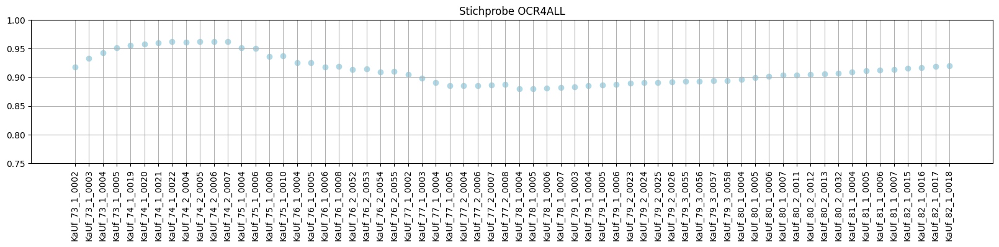

In [14]:
import matplotlib.pylab as plt

myList = average_page_dict.items()
myList = sorted(myList) 
x, y = zip(*myList) 

f = plt.figure()
f.set_figwidth(20)
f.set_figheight(3)
plt.title("Stichprobe OCR4ALL")
plt.scatter(x, y, color='lightblue')
plt.ylim(0.75, 1)

plt.xticks(rotation=90)
plt.grid(True)
plt.show()